In [ ]:
!pip install tf-explain
!pip install vit_keras
!pip install tensorflow-addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 743.2 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 3.9 MB/s eta 0:00:00


In [ ]:
!pip install keras --upgrade

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 999.1/999.1 kB 9.8 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.14.0
    Uninstalling keras-2.14.0:
      Successfully uninstalled keras-2.14.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.14.0 requires keras<2.15,>=2.14.0, but you have keras 3.0.1 which is incompatible.


In [ ]:
tf.__version__

NameError: ignored

In [ ]:
import zipfile
import os
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import tensorflow as tf
import sklearn

import numpy as np

from sklearn.model_selection import train_test_split
from tensorflow.keras import models, layers, regularizers
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import LearningRateScheduler, ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras import backend as K
from tf_explain.core.grad_cam import GradCAM

import random,cv2
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score

from vit_keras import vit, utils, visualize

os.environ["KERAS_BACKEND"] = "jax"
### @param ["tensorflow", "jax", "torch"]

import keras
from keras import layers
#from keras import ops

%matplotlib inline

In [ ]:
!wget -c https://scholar.cu.edu.eg/Dataset_BUSI.zip --no-check-certificate
!unzip /content/Dataset_BUSI.zip


--2023-12-14 01:08:59--  https://scholar.cu.edu.eg/Dataset_BUSI.zip
Resolving scholar.cu.edu.eg (scholar.cu.edu.eg)... 195.246.42.194
Connecting to scholar.cu.edu.eg (scholar.cu.edu.eg)|195.246.42.194|:443... connected.
  Unable to locally verify the issuer's authority.
HTTP request sent, awaiting response... 200 OK
Length: 205873341 (196M) [application/zip]
Saving to: ‘Dataset_BUSI.zip’

Dataset_BUSI.zip    100%[===================>] 196.34M   358KB/s    in 9m 28s  

2023-12-14 01:18:29 (354 KB/s) - ‘Dataset_BUSI.zip’ saved [205873341/205873341]

Archive:  /content/Dataset_BUSI.zip
   creating: Dataset_BUSI_with_GT/
   creating: Dataset_BUSI_with_GT/benign/
  inflating: Dataset_BUSI_with_GT/benign/benign (1).png  
  inflating: Dataset_BUSI_with_GT/benign/benign (1)_mask.png  
  inflating: Dataset_BUSI_with_GT/benign/benign (10).png  
  inflating: Dataset_BUSI_with_GT/benign/benign (10)_mask.png  
  inflating: Dataset_BUSI_with_GT/benign/benign (100).png  
  inflating: Dataset_BUSI_wit

In [ ]:
class configuration():
  def __init__(self):
    self.set_image()
    self.set_model()
    self.set_dir()

  def set_image(self):
    self.BATCH_SIZE = 32
    self.TEST_SIZE  = 0.2
    self.SEED       = 24
    self.SHUFFLE    = True
    self.AUTOTUNE   = tf.data.AUTOTUNE
    self.HEIGHT     = 256
    self.WIDTH      = 256
    self.DEPTH      = 3
    self._size      = 256

  @property
  def SIZE(self):
    if (self.HEIGHT != self.WIDTH):
      raise ValueError("size, height width mis match in config")
    return(self._size)

  @SIZE.setter
  def SIZE(self,value):
    self._size  = value
    self.WIDTH  = value
    self.HEIGHT = value
    return(self._size)

  def set_model(self):
    self.LR = 0.001
    self.NUM_EPOCHS=25

  def set_dir(self):
    self.DATA_DIR  = 'Dataset_BUSI_with_GT/'
    self.BENIGN    = 'benign'
    self.MALIGNANT = 'malignant'
    self.NORMAL    = 'normal'

    self.BENIGN_DIR    = os.path.join(self.DATA_DIR,self.BENIGN)
    self.MALIGNANT_DIR = os.path.join(self.DATA_DIR,self.MALIGNANT)
    self.NORMAL_DIR    = os.path.join(self.DATA_DIR,self.NORMAL)


config = configuration()

config.SIZE = 224


In [ ]:
config.DATA_DIR = 'Dataset_BUSI_with_GT/'

for i in os.listdir(config.DATA_DIR):
    print(os.path.join(config.DATA_DIR,i))
    if os.path.isdir(os.path.join(config.DATA_DIR,i)):
        print(len(os.listdir(os.path.join(config.DATA_DIR,i))))
#os.listdir('../data/raw/The IQ-OTHNCCD lung cancer dataset/The IQ-OTHNCCD lung cancer dataset/Bengin cases')

Dataset_BUSI_with_GT/normal
266
Dataset_BUSI_with_GT/benign
891
Dataset_BUSI_with_GT/malignant
421


['benign']


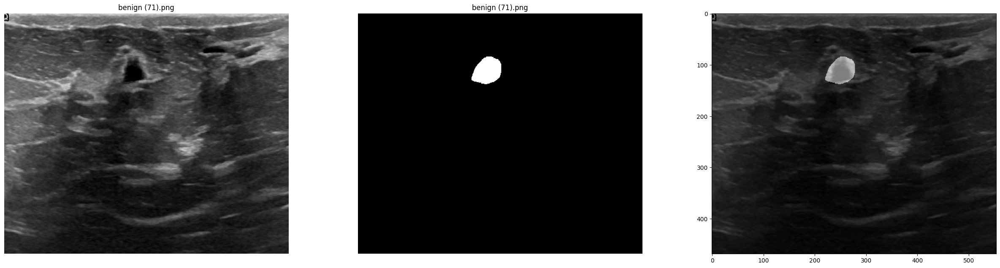

['benign']


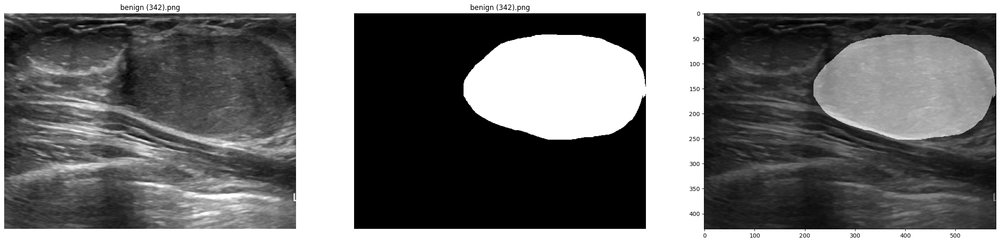

['malignant']


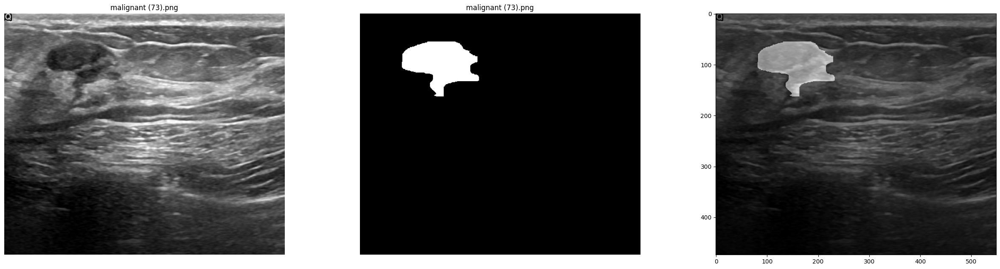

['malignant']


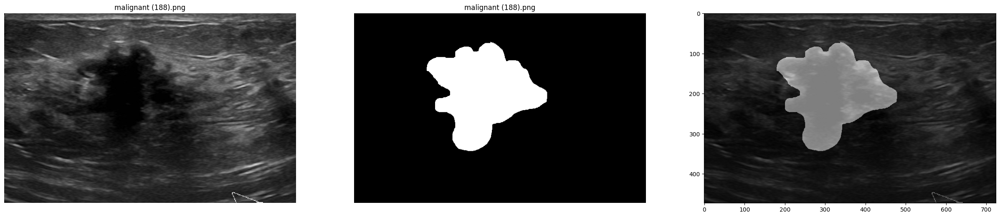

['normal']


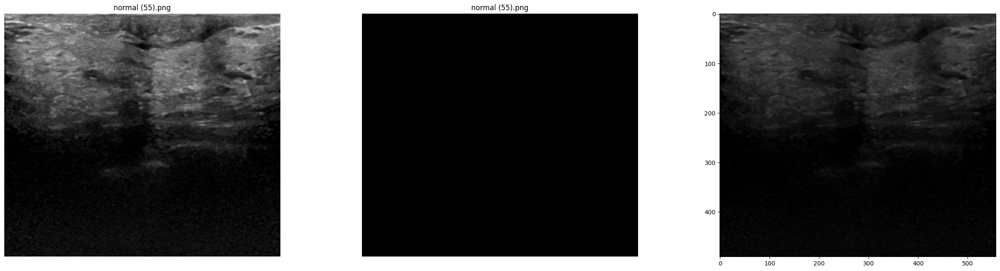

['normal']


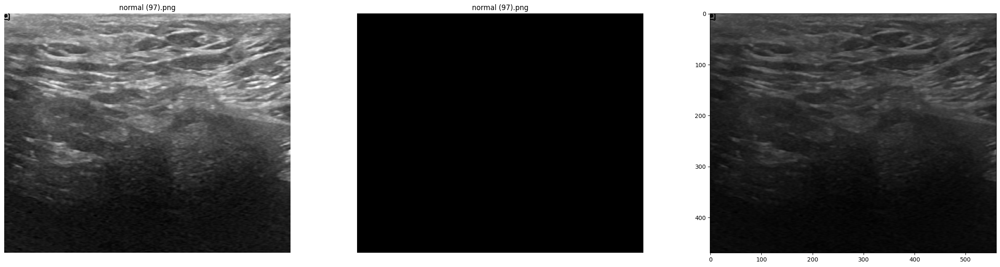

In [ ]:
def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    np.random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [config.BENIGN,config.NORMAL,config.MALIGNANT] if all([i in [config.BENIGN,config.NORMAL,config.MALIGNANT], i in image])])
            cls = [i for i in [config.BENIGN,config.NORMAL,config.MALIGNANT] if all([i in [config.BENIGN,config.NORMAL,config.MALIGNANT], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Convert the mask to a binary image
            msk_binary = cv2.cvtColor(msk, cv2.COLOR_BGR2GRAY)
            #print(msk_binary.shape)
            ret, msk_binary = cv2.threshold(msk_binary, 1, 255, cv2.THRESH_BINARY)
            #print(msk_binary.shape)

            plot3(img, msk, image)

def plot3(img1, img2, title=None):
    fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)

    for i, img in enumerate([img1, img2]):
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
        if title:
            axs[i].set_title(title)
    axs[2].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    axs[2].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB),alpha=0.5)
    plt.show()


# Select 8 random images from each class
benign_images = select_random_images(config.BENIGN_DIR, 2)
malignant_images = select_random_images(config.MALIGNANT_DIR, 2)
normal_images = select_random_images(config.NORMAL_DIR, 2)

In [ ]:
# Create lists to store the data
categories = []
num_images = []
num_masks = []
smallest_size_x = []
smallest_size_y = []

# Loop through the categories
for i in [config.BENIGN, config.MALIGNANT, config.NORMAL]:
    path_list = os.listdir(os.path.join(config.DATA_DIR, i))
    non_mask = len([j for j in path_list if 'mask' not in j])
    mask = len([j for j in path_list if 'mask' in j])

    categories.append(i)
    num_images.append(non_mask)
    num_masks.append(mask)

    sizes_x = [cv2.imread(os.path.join(config.DATA_DIR, i, j)).shape[0] for j in path_list if 'mask' not in j]
    sizes_y = [cv2.imread(os.path.join(config.DATA_DIR, i, j)).shape[1] for j in path_list if 'mask' not in j]

    smallest_size_x.append(min(sizes_x))
    smallest_size_y.append(min(sizes_y))

# Create a DataFrame
df = pd.DataFrame({
    'Category': categories,
    'Number of Images': num_images,
    'Number of Masks': num_masks,
    'Smallest Size X': smallest_size_x,
    'Smallest Size Y': smallest_size_y
})

# Display the DataFrame
df


,Category,Number of Images,Number of Masks,Smallest Size X,Smallest Size Y
0,benign,437,454,324,315
1,malignant,210,211,332,190
2,normal,133,133,310,391


<Axes: >

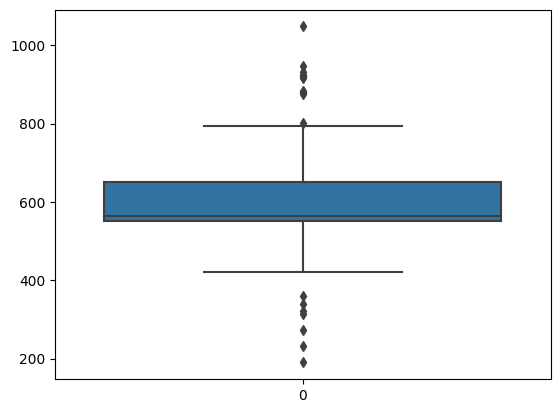

In [ ]:
path_list = os.listdir(os.path.join(config.DATA_DIR, config.MALIGNANT))
sizes_y = [cv2.imread(os.path.join(config.DATA_DIR, config.MALIGNANT, j)).shape[1] for j in path_list if 'mask' not in j]
sns.boxplot(sizes_y)

In [ ]:
def load_image(path, size, model):
    image = cv2.imread(path)
    image = cv2.resize(image, (size,size))
    if model=='ResNet152V2':
      image = tf.keras.applications.resnet_v2.preprocess_input(image)
    elif model=='VGG19':
      image = tf.keras.applications.vgg19.preprocess_input(image)
    elif model=='EfficientNetB7':
      image = tf.keras.applications.efficientnet.preprocess_input(image)
    elif model=='EfficientNetV2S':
      image = tf.keras.applications.efficientnet_v2.preprocess_input(image)
    elif model=='ConvNeXtBase':
      pass
    elif model=='vit_b16':
      image = vit.preprocess_inputs(image)
    if config.DEPTH==1:
      image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    #image = image/255.
    return image

def load_data(path, size, state, model):
    images = []
    masks  = []

    imagesmask_path = os.listdir(os.path.join(config.DATA_DIR,state))
    images_path = [i for i in imagesmask_path if 'mask' not in i]
    mask_path   = [i for i in imagesmask_path if 'mask' in i]
    #print(images_path,mask_path)
    for path in images_path:
        #print(path)
        file = os.path.basename(path).replace('.png','')
        #print(file)
        mfiles=[]
        for mfile in mask_path:
            if file in mfile:
                mfiles.append(mfile)
        #if '100' in file:print(mfiles)
        if len(mfiles)==0:
            print(mfiles)
            continue
        elif len(mfiles)==1:
            images.append(load_image(os.path.join(config.DATA_DIR,state,path), size, model))
            masks.append(load_image(os.path.join(config.DATA_DIR,state,mfiles[0]), size, model))
            #if '248' in file:print(load_image(os.path.join(config.DATA_DIR,state,mfiles[0]), size)[150])
        elif len(mfiles)>1:
            img = 0
            for mfile in mfiles:
                img += load_image(os.path.join(config.DATA_DIR,state,mfile), size, model)
                #if '25' in file:print(img[60],'--'*10)
                #img+=img
                #if '100' in file:print('summed',img[60],'--'*10)

                #print(mfile)
            #if '25' in file:print(img[60]/len(mfiles))
            img = np.array(img>0.5, dtype='float64')
            images.append(load_image(os.path.join(config.DATA_DIR,state,path), size, model))
            #masks.append(img/len(mfiles))
            masks.append(np.array(img>0.5, dtype='float64'))
            #print()

    return np.array(images,dtype=np.float32), np.array(masks,dtype=np.float32)

#model = 'ResNet152V2'
#model = 'VGG19'
model = 'EfficientNetB7'
#model = 'EfficientNetV2S'
#model = 'ConvNeXtBase'
#model = 'vit_b16'

x_benign, y_benign = load_data(config.DATA_DIR, config.SIZE, config.BENIGN, model )
x_malignant, y_malignant = load_data(config.DATA_DIR, config.SIZE, config.MALIGNANT, model)
x_normal, y_normal = load_data(config.DATA_DIR, config.SIZE, config.NORMAL, model)

In [ ]:
y_normal_label    = np.array([[1,0,0] for i in range(len(y_normal))])
y_benign_label    = np.array([[0,1,0] for i in range(len(y_benign))])
y_malignant_label = np.array([[0,0,1] for i in range(len(y_malignant))])


In [ ]:
x_benign.shape
y_benign_label.shape

(437, 224, 224, 3)

(437, 3)

In [ ]:
ny = len(y_benign_label) + len(y_malignant_label) + len(y_normal_label)
n_classes = 3
class_weight = {0: ny/(n_classes*len(y_normal_label)),
                1: ny/(n_classes*len(y_benign_label)),
                2: ny/(n_classes*len(y_malignant_label))}

In [ ]:
class_weight

{0: 1.9548872180451127, 1: 0.5949656750572082, 2: 1.2380952380952381}

In [ ]:
if config.DEPTH==1:
  # prepare data to modeling
  x_benign = np.expand_dims(x_benign, -1)
  y_benign = np.expand_dims(y_benign, -1)

  # prepare data to modeling
  x_malignant = np.expand_dims(x_malignant, -1)
  y_malignant = np.expand_dims(y_malignant, -1)

  # prepare data to modeling
  x_normal = np.expand_dims(x_normal, -1)
  y_normal = np.expand_dims(y_normal, -1)

In [ ]:
x_total_label = np.concatenate((x_benign, x_malignant, x_normal), axis=0)
y_total_label = np.concatenate((y_benign_label, y_malignant_label, y_normal_label), axis=0)
random_state = 24
y_total_label = np.expand_dims(y_total_label, -1)

X_train_total_label, X_test_total_label, y_train_total_label, y_test_total_label = train_test_split(
                                                                                   x_total_label,
                                                                                   y_total_label,
                                                                                   test_size=config.TEST_SIZE,
                                                                                   shuffle=config.SHUFFLE,
                                                                                   random_state=config.SEED)


#y_malignant = np.expand_dims(y_malignant, -1)
y_train_total_label = np.reshape(y_train_total_label,(-1,3))
y_test_total_label = np.reshape(y_test_total_label,(-1,3))

In [ ]:
x_total = np.concatenate((x_benign,x_malignant), axis=0)
y_total = np.concatenate((y_benign,y_malignant), axis=0)

X_train_total, X_test_total, y_train_total, y_test_total = train_test_split(x_total,
                                                                            y_total,
                                                                            test_size=config.TEST_SIZE,
                                                                            shuffle=config.SHUFFLE,
                                                                            random_state=config.SEED)

In [ ]:
ds_train = tf.data.Dataset.from_tensor_slices((X_train_total, y_train_total))
ds_test = tf.data.Dataset.from_tensor_slices((X_test_total, y_test_total))

In [ ]:
ds_train_label = tf.data.Dataset.from_tensor_slices((X_train_total_label, y_train_total_label))
ds_test_label  = tf.data.Dataset.from_tensor_slices((X_test_total_label, y_test_total_label))

In [ ]:
def prepare_dataset(x,y,batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.batch(batch_size).cache().prefetch(buffer_size=config.AUTOTUNE)
    return dataset

dataset_train = prepare_dataset(X_train_total, y_train_total, config.BATCH_SIZE)
#dataset_val = prepare_dataset(val_df_scaled,62)
dataset_test = prepare_dataset(X_test_total,y_test_total,1)

dataset_train_label = prepare_dataset(X_train_total_label, y_train_total_label, config.BATCH_SIZE)
#dataset_val = prepare_dataset(val_df_scaled,62)
dataset_test_label = prepare_dataset(X_test_total_label,y_test_total_label,1)

In [ ]:
tf.keras.backend.clear_session()

In [ ]:
sample_image = X_train_total[0]

def plot_augmentations(augmentation_layer: tf.keras.layers.Layer) -> None:
    augment_name = augmentation_layer.name
    fig, (ax0, *axes) = plt.subplots(ncols=4, figsize=(15, 4))
    ax0.imshow(sample_image)
    ax0.set_title("Original", size=14, pad=10)
    ax0.axis("off")
    for idx, ax in enumerate(axes):
        augmented_image = augmentation_layer(sample_image)
        ax.imshow(augmented_image)
        ax.set_title(augment_name.title(), size=14, pad=10)
        ax.axis("off")

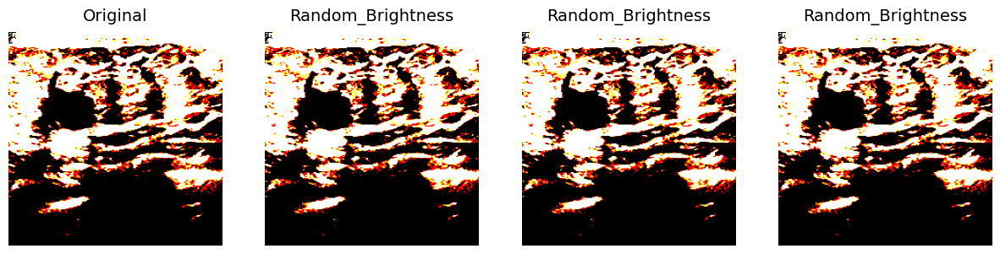

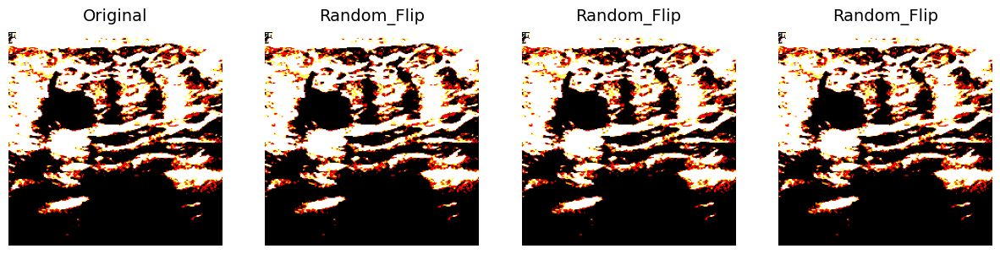

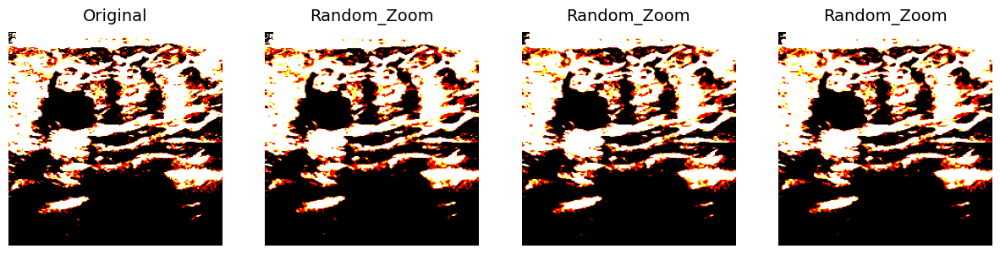

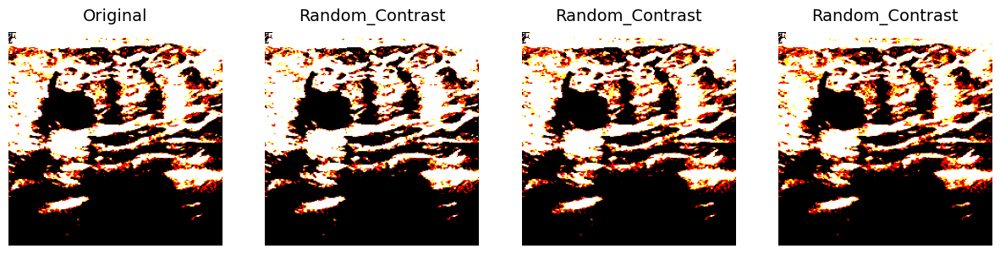

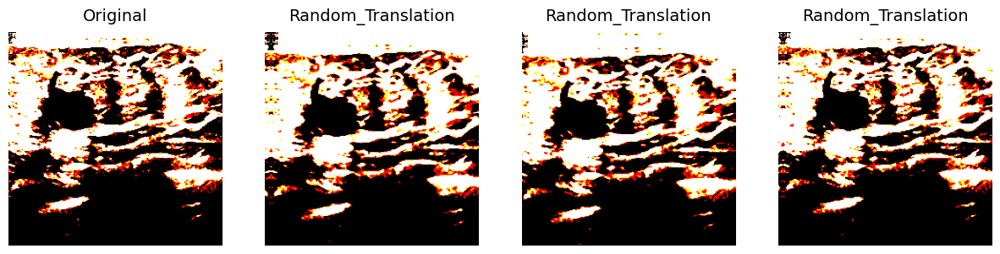

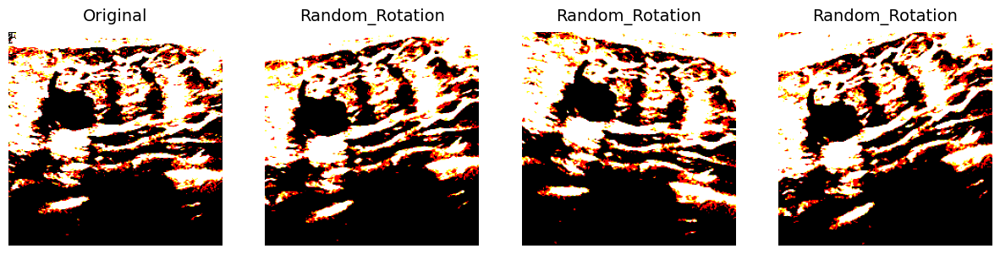

In [ ]:
plot_augmentations(tf.keras.layers.RandomBrightness(0.0004))
plot_augmentations(tf.keras.layers.RandomFlip())
plot_augmentations(tf.keras.layers.RandomZoom(0.01))
plot_augmentations(tf.keras.layers.RandomContrast(0.2))
plot_augmentations(tf.keras.layers.RandomTranslation(height_factor=0.05,width_factor=0.05))
plot_augmentations(tf.keras.layers.RandomRotation(0.05,seed=config.SEED))

In [ ]:
tf.keras.backend.clear_session()

def augmentation_layer(x):
    x = tf.keras.layers.RandomFlip(input_shape=(config.HEIGHT,
                                                config.WIDTH,
                                                config.DEPTH),
                                  seed=config.SEED,
                                  name='random_flip')(x)
    x = tf.keras.layers.RandomBrightness(0.0004,
                                         seed=config.SEED,
                                         name='random_brightness')(x)
    x = tf.keras.layers.RandomZoom(0.01,
                                   seed=config.SEED,
                                   name='random_zoom')(x)
    x = tf.keras.layers.RandomContrast(0.2,
                                       seed=config.SEED,
                                       name='random_contrast')(x)
    x = tf.keras.layers.RandomTranslation(height_factor=0.05,
                                          width_factor=0.05,
                                          seed=config.SEED,
                                          name='random_translation')(x)
    x = tf.keras.layers.RandomRotation(0.05,
                                       seed=config.SEED,
                                       name='random_rotation')(x)
    return x

#convolutional block
def conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'1')(x)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'1BN')(conv)
    conv = layers.Activation("relu",name=name+'1BNact')(conv)
    if dropout > 0:
        conv = layers.Dropout(dropout)(conv)
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'2')(conv)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'2BN')(conv)
    conv = layers.Activation("relu",name=name+'2BNact')(conv)
    return conv


#residual convolutional block
def res_conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv1 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same', name=name+'1')(x)
    if batchnorm is True:
        conv1 = layers.BatchNormalization(axis=3,name=name+'1BN')(conv1)
    conv1 = layers.Activation('relu')(conv1)
    conv2 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same')(conv1)
    if batchnorm is True:
        conv2 = layers.BatchNormalization(axis=3)(conv2)
        conv2 = layers.Activation("relu")(conv2)
    if dropout > 0:
        conv2 = layers.Dropout(dropout)(conv2)

    #skip connection
    shortcut = layers.Conv2D(filters, kernel_size=(1, 1), kernel_initializer='he_normal', padding='same')(x)
    if batchnorm is True:
        shortcut = layers.BatchNormalization(axis=3)(shortcut)
    shortcut = layers.Activation("relu")(shortcut)
    respath = layers.add([shortcut, conv2], name=name+'resfinal')
    return respath


#gating signal for attention unit
def gatingsignal(input, out_size, batchnorm=False, name='gate'):
    x = layers.Conv2D(out_size, (1, 1), padding='same')(input)
    if batchnorm:
        x = layers.BatchNormalization()(x)
    x = layers.Activation('relu',name=name+'_act')(x)
    return x

#attention unit/block based on soft attention
def attention_block(x, gating, inter_shape, name):
    shape_x = K.int_shape(x)
    shape_g = K.int_shape(gating)
    theta_x = layers.Conv2D(inter_shape, (2, 2), strides=(2, 2),
                            kernel_initializer='he_normal', padding='same')(x)
    shape_theta_x = K.int_shape(theta_x)
    phi_g = layers.Conv2D(inter_shape, (1, 1), kernel_initializer='he_normal', padding='same')(gating)
    upsample_g = layers.Conv2DTranspose(inter_shape, (3, 3), strides=(shape_theta_x[1] // shape_g[1], shape_theta_x[2] // shape_g[2]), kernel_initializer='he_normal', padding='same')(phi_g)
    concat_xg = layers.add([upsample_g, theta_x])
    act_xg = layers.Activation('relu')(concat_xg)
    psi = layers.Conv2D(1, (1, 1), kernel_initializer='he_normal', padding='same')(act_xg)
    sigmoid_xg = layers.Activation('sigmoid')(psi)
    shape_sigmoid = K.int_shape(sigmoid_xg)
    upsample_psi = layers.UpSampling2D(size=(shape_x[1] // shape_sigmoid[1], shape_x[2] // shape_sigmoid[2]))(sigmoid_xg)
    upsample_psi = layers.Lambda(lambda x, repnum: K.repeat_elements(x, repnum, axis=3), arguments={'repnum': shape_x[3]})(upsample_psi)
    y = layers.multiply([upsample_psi, x])
    result = layers.Conv2D(shape_x[3], (1, 1), kernel_initializer='he_normal', padding='same')(y)
    attenblock = layers.BatchNormalization(name=name+'_wgt')(result)
    return attenblock

#Simple U-NET
def unetmodel(input_shape, dropout=0.2, batchnorm=False):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm,name='conv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_5')(dn_5)
    up_5 = layers.concatenate([up_5, dn_4], axis=3, name='ups_5_conv_4')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='ups_conv5')

    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, dn_3], axis=3, name='ups_4_conv_3')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='ups_conv4')

    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, dn_2], axis=3, name='ups_3_conv_2')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='ups_conv3')

    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, dn_1], axis=3, name='ups_2_conv_1')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='ups_conv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3,name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Attention U-NET
def attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='dconv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='dconv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='dconv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='dconv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='dconv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate_5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att_5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3, name='up_5_att_5')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='uconv_5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate_4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att_4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3, name='up_4_att_4')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='uconv_4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate_3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att_3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3, name='up_3_att_3')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='uconv_3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate_2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att_2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3, name='up_2_att_2')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='uconv_2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Residual-Attention UNET (RA-UNET)
def residual_attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = res_conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='conv_1')
    pool1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = res_conv_block(pool1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = res_conv_block(pool2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = res_conv_block(pool3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = res_conv_block(pool4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3)
    up_conv_5 = res_conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='upconv5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3)
    up_conv_4 = res_conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='upconv4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3)
    up_conv_3 = res_conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='upconv3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3)
    up_conv_2 = res_conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='upconv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

pretrained_efficientnet_base = tf.keras.applications.EfficientNetB7(
    include_top=False,
    input_shape=(config.SIZE, config.SIZE, config.DEPTH),
    weights="imagenet",
    pooling="avg",
)

pretrained_efficientnet_base.trainable=False
from tensorflow.keras import regularizers, initializers

efficientnet_model = tf.keras.Sequential([
    layers.Input(shape=(config.SIZE, config.SIZE, config.DEPTH)),
    # EfficientNet
    pretrained_efficientnet_base,
    layers.Flatten(),
    layers.Dropout(0.5),
    # Fully connected layers
    layers.Dense(
        256,
        activation="relu",
        kernel_regularizer=regularizers.l2(0.01),  # L2 regularization
        bias_regularizer=regularizers.l2(0.01),
        kernel_initializer=initializers.glorot_uniform(),  # Glorot (Xavier) initialization
    ),
    layers.BatchNormalization(),
    layers.Dropout(0.3),
    layers.Dense(
        32,
        activation="relu",
        kernel_regularizer=regularizers.l2(0.01),
        bias_regularizer=regularizers.l2(0.01),
        kernel_initializer=initializers.glorot_uniform(),
    ),
    layers.BatchNormalization(),
    layers.Dropout(0.2),
    layers.Dense(
        3,
        activation="softmax",
        kernel_regularizer=regularizers.l2(0.01),
        bias_regularizer=regularizers.l2(0.01),
        kernel_initializer=initializers.glorot_uniform(),
    )
], name="EfficientNetB1")

VGG_model = tf.keras.Sequential()

pretrained_model= tf.keras.applications.VGG19(include_top=False,
                   input_shape=(224,224,3),
                   pooling='max',classes=3,
                   weights='imagenet')


VGG_model.add(pretrained_model)
VGG_model.add(tf.keras.layers.Flatten())
VGG_model.add(tf.keras.layers.Dense(512, activation='relu'))
VGG_model.add(tf.keras.layers.BatchNormalization())  # Batch Normalization layer
VGG_model.add(tf.keras.layers.Dropout(0.5))

VGG_model.add(tf.keras.layers.Dense(3, activation='softmax'))
pretrained_model.trainable=False


258076736/258076736 [==============================] - 11s 0us/step


In [ ]:
#import tensorflow as tf
#from tf.keras.layers import Input, Flatten, Dense, BatchNormalization, Dropout
tf.keras.backend.clear_session()


POOLING = 'max'

# Input layer
input_layer = tf.keras.layers.Input(shape=(224, 224, 3))

if model=='ResNet152V2':
  pretrained_model = tf.keras.applications.ResNet152V2(
    include_top=False,
    input_shape=(config.SIZE, config.SIZE, config.DEPTH),
    weights="imagenet",
    pooling=POOLING,
    )(input_layer)
  pretrained_model.trainable=False
elif model=='VGG19':
  pretrained_model = tf.keras.applications.VGG19(
    include_top=False,
    input_shape=(config.SIZE, config.SIZE, config.DEPTH),
    pooling=POOLING,
    weights='imagenet'
    )(input_layer)
elif model=='EfficientNetB7':
  pretrained_model = tf.keras.applications.EfficientNetB7(
    include_top=False,
    input_shape=(config.SIZE, config.SIZE, config.DEPTH),
    weights="imagenet",
    pooling=POOLING,
    )(input_layer)
elif model=='EfficientNetV2S':
  pretrained_model = tf.keras.applications.EfficientNetV2S(
    include_top=False,
    input_shape=(config.SIZE, config.SIZE, config.DEPTH),
    weights="imagenet",
    pooling=POOLING,
    )(input_layer)
elif model=='ConvNeXtBase':
  pretrained_model = tf.keras.applications.ConvNeXtBase(
    model_name="convnext_base",
    include_top=False,
    include_preprocessing=True,
    weights="imagenet",
    pooling=POOLING,
    )(input_layer)
elif model=='vit_b16':
  pretrained_model = vit.vit_b16(
    #image_size=image_size,
    #activation='sigmoid',
    pretrained = True,
    include_top = False,
    pretrained_top = False,
    )(input_layer)

# Flatten layer
flattened = tf.keras.layers.Flatten()(pretrained_model)

# Dense layers
#dense1 = tf.keras.layers.Dense(256, activation='relu',
              #kernel_regularizer=regularizers.l2(0.01),  # L2 regularization
              #bias_regularizer=regularizers.l2(0.01))(flattened)
#batch_norm1 = tf.keras.layers.BatchNormalization()(dense1)
#dropout1 = tf.keras.layers.Dropout(0.5)(batch_norm1)
dense1 = tf.keras.layers.Dense(256, activation='relu',
              kernel_regularizer=regularizers.l2(0.01),  # L2 regularization
              bias_regularizer=regularizers.l2(0.01))(flattened)
batch_norm1 = tf.keras.layers.BatchNormalization()(dense1)
dropout1 = tf.keras.layers.Dropout(0.3)(batch_norm1)
dense2 = tf.keras.layers.Dense(64, activation='relu',
              kernel_regularizer=regularizers.l2(0.01),  # L2 regularization
              bias_regularizer=regularizers.l2(0.01),)(dropout1)
batch_norm2 = tf.keras.layers.BatchNormalization()(dense2)
dropout2 = tf.keras.layers.Dropout(0.2)(batch_norm2)
output_layer = tf.keras.layers.Dense(3, activation='softmax')(dropout2)


# Functional model
fine_tune_model = tf.keras.Model(inputs=input_layer, outputs=output_layer)
pretrained_model.trainable=False

258076736/258076736 [==============================] - 7s 0us/step


In [ ]:
fine_tune_model.summary()
fine_tune_model.layers[1].trainable=False
fine_tune_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb7 (Functional  (None, 2560)              64097687  
 )                                                               
                                                                 
 flatten (Flatten)           (None, 2560)              0         
                                                                 
 dense (Dense)               (None, 256)               655616    
                                                                 
 batch_normalization (Batch  (None, 256)               1024      
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 256)               0     

In [ ]:
def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def dice_coef_logloss(y_true, y_pred):
    return -K.log(dice_coef(y_true, y_pred))

def bce_dice_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def dice_coef_multilabel(y_true, y_pred, M, smooth):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth)
    return dice

def dice_coef_multilabel(y_true, y_pred, M, smooth_list):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth_list[index])
    return dice

def metric_dice():
  def dice_coef(y_true, y_pred):
      smooth = 1.
      y_true_f = K.flatten(y_true)
      y_pred_f = K.flatten(y_pred)
      intersection = K.sum(y_true_f * y_pred_f)
      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
      return dice
  return dice_coef

def metric_meanIoU(thres=0.4):
  def metric(y_true,y_pred):
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    smooth=0
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    mean_iou = K.mean((intersection + smooth) / (union + smooth))
    return mean_iou
  return metric

def recall(y_true, y_pred, c):
    #tf.print(y_true)
    pred_labels = K.cast(K.argmax(y_pred, axis=-1), K.floatx())
    true_labels = K.cast(K.argmax(y_true, axis=-1), K.floatx())
    #tf.print(K.argmax(y_true, axis=-1))
    #tf.print(K.argmax(y_pred, axis=-1))
    #tf.print(true_labels)
    #tf.print(pred_labels)
    #tf.print(true_labels == c)
    #tf.print(tf.logical_and(true_labels == c, pred_labels == c))
    #tf.print(K.cast(tf.logical_and(true_labels == c, pred_labels == c),K.floatx()))
    #tf.print(tf.reduce_sum(K.cast(tf.logical_and(true_labels == c, pred_labels == c),K.floatx())))
    #tf.print(type(tf.logical_and(true_labels == c, pred_labels == c)))

    tp = K.sum(K.cast(tf.logical_and(true_labels == c, pred_labels == c),K.floatx()))
    fn = K.sum(K.cast(tf.logical_and(true_labels == c, pred_labels != c),K.floatx()))
    tn = K.sum(K.cast(tf.logical_and(true_labels != c, pred_labels != c),K.floatx()))
    fp = K.sum(K.cast(tf.logical_and(true_labels != c, pred_labels == c),K.floatx()))

    sensitivity = (tp)/(tp+fn+0.0000001)
    return sensitivity


def precision(y_true, y_pred, c):
    pred_labels = K.cast(K.argmax(y_pred, axis=-1), K.floatx())
    true_labels = K.cast(K.argmax(y_true, axis=-1), K.floatx())

    tp = K.sum(K.cast(tf.logical_and(true_labels == c, pred_labels == c),K.floatx()))
    fn = K.sum(K.cast(tf.logical_and(true_labels == c, pred_labels != c),K.floatx()))
    tn = K.sum(K.cast(tf.logical_and(true_labels != c, pred_labels != c),K.floatx()))
    fp = K.sum(K.cast(tf.logical_and(true_labels != c, pred_labels == c),K.floatx()))

    precision = (tp)/(tp+fp+0.0000001)
    return precision

def recall_c0(y_true, y_pred):
    return recall(y_true, y_pred, 0)

def precision_c0(y_true, y_pred):
    return precision(y_true, y_pred, 0)

def recall_c1(y_true, y_pred):
    return recall(y_true, y_pred, 1)

def precision_c1(y_true, y_pred):
    return precision(y_true, y_pred, 1)

def recall_c2(y_true, y_pred):
    return recall(y_true, y_pred, 2)

def precision_c2(y_true, y_pred):
    return precision(y_true, y_pred, 2)

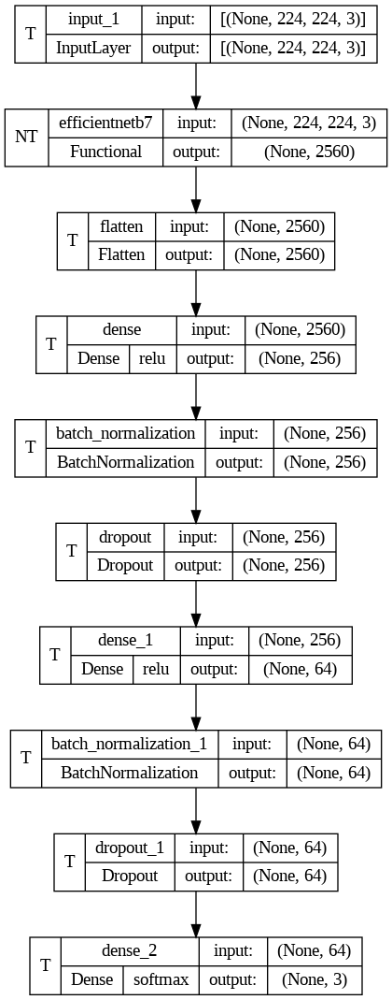

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb7 (Functional  (None, 2560)              64097687  
 )                                                               
                                                                 
 flatten (Flatten)           (None, 2560)              0         
                                                                 
 dense (Dense)               (None, 256)               655616    
                                                                 
 batch_normalization (Batch  (None, 256)               1024      
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 256)               0     

In [ ]:

#model = residual_attentionunet(input_shape=(256,256,1))

#model = attentionunet(input_shape=(256,256,1))
#model = unetmodel(input_shape=(256,256,1))
#runet_model = residual_attentionunet(input_shape=(256,256,1))

#model = efficientnet_model
#model = VGG_model
#resnet152v2.trainable=False

tf.keras.utils.plot_model(fine_tune_model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True,
                          to_file=model+'plot.png')
fine_tune_model.summary()

In [ ]:


METRICS = [
      #tf.keras.metrics.BinaryCrossentropy(name='cross entropy'),  # same as model's loss
      #tf.keras.metrics.MeanSquaredError(name='Brier score'),
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'),
      #tf.keras.metrics.Accuracy(name='accuracy'),
      #tf.keras.metrics.Precision(name='precision'),
      #tf.keras.metrics.Recall(name='recall'),
      #tf.keras.metrics.AUC(name='auc'),
      #tf.keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

fine_tune_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002),
              #loss=dice_coef_loss,
              #loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False),
              loss = tf.keras.losses.CategoricalCrossentropy(),
              #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
              metrics = [recall_c0,recall_c1,recall_c2,
                         precision_c0,precision_c1,precision_c2],
              #metrics = [recall_c2],
              #run_eagerly=True
              )
#binary cross entropy
#NUM_EPCHS=15

In [ ]:
def load_wgt():
  model.load_weights('best_model.hdf5', skip_mismatch=False, by_name=False, options=None)

#load_wgt()

In [ ]:
#config.NUM_EPOCHS=1
checkpoint = ModelCheckpoint(model+'weights.hdf5' ,
                             monitor = 'val_loss',
                             verbose = 1,
                             save_best_only=True,
                             mode = 'min',
                             save_weights_only=True,
                             save_freq='epoch'
                            )

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.3,
                              patience=15, min_lr=0.00005)

callbacks_list = [checkpoint, reduce_lr]

# Fit model
history = fine_tune_model.fit(dataset_train_label,
                    validation_data=dataset_test_label,
                    #steps_per_epoch=len(X_train)/(6),
                    #validation_steps=10,
                    callbacks=callbacks_list,
                    epochs=config.NUM_EPOCHS,
                    class_weight=class_weight,
                    #verbose=2,
                    )

20/20 [==============================] - ETA: 0s - loss: 6.8860 - recall_c0: 0.6855 - recall_c1: 0.4394 - recall_c2: 0.4620 - precision_c0: 0.3163 - precision_c1: 0.7365 - precision_c2: 0.4097 
Epoch 1: val_loss improved from inf to 7.20259, saving model to EfficientNetB7weights.hdf5
20/20 [==============================] - 440s 20s/step - loss: 6.8860 - recall_c0: 0.6855 - recall_c1: 0.4394 - recall_c2: 0.4620 - precision_c0: 0.3163 - precision_c1: 0.7365 - precision_c2: 0.4097 - val_loss: 7.2026 - val_recall_c0: 0.1090 - val_recall_c1: 0.1346 - val_recall_c2: 0.2244 - val_precision_c0: 0.1090 - val_precision_c1: 0.1346 - val_precision_c2: 0.2244 - lr: 2.0000e-04


In [ ]:

#no cls wgt : 20/20 [==============================] - 43s 2s/step - loss: 1.9448 - recall_c0: 0.8903 - recall_c1: 0.5598 - recall_c2: 0.8454 - precision_c0: 0.6223 - precision_c1: 0.8988 - precision_c2: 0.5330 - val_loss: 1.9319 - val_recall_c0: 0.1218 - val_recall_c1: 0.3526 - val_recall_c2: 0.2115 - val_precision_c0: 0.1218 - val_precision_c1: 0.3526 - val_precision_c2: 0.2115 - lr: 2.0000e-04
#cls weights: 20/20 [==============================] - 18s 925ms/step - loss: 1.5396 - recall_c0: 0.9061 - recall_c1: 0.5620 - recall_c2: 0.8922 - precision_c0: 0.5050 - precision_c1: 0.9605 - precision_c2: 0.6514 - val_loss: 1.7065 - val_recall_c0: 0.1667 - val_recall_c1: 0.2949 - val_recall_c2: 0.1923 - val_precision_c0: 0.1667 - val_precision_c1: 0.2949 - val_precision_c2: 0.1923 - lr: 2.0000e-04


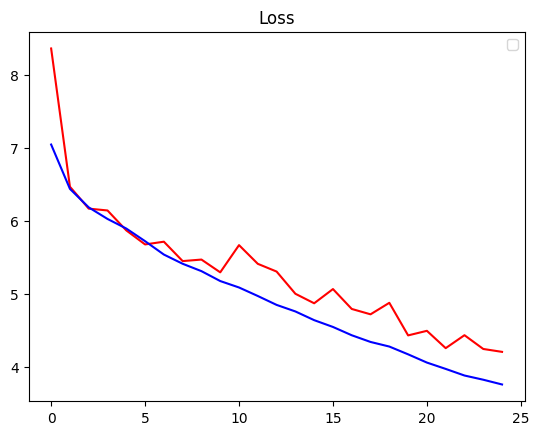

In [ ]:
def plot_loss_history(history):
    # validation losses
    val_loss = history.history['val_loss']
    loss = history.history['loss']

    plt.title('Loss')
    plt.plot(val_loss, 'r', loss, 'b')
    plt.legend()
    plt.show()

plot_loss_history(history)

#unet:    33/33 [==============================] - 7s 214ms/step - loss: 0.4043 - metric: 0.4867 - dice_coef: 0.3052 - val_loss: 0.4089 - val_metric: 0.5332 - val_dice_coef: 0.2121 - lr: 0.0010
#attunet: 33/33 [==============================] - 12s 362ms/step - loss: 0.4014 - metric: 0.4877 - dice_coef: 0.3069 - val_loss: 0.3977 - val_metric: 0.3644 - val_dice_coef: 0.2074 - lr: 0.0010
#reunet:  33/33 [==============================] - 14s 414ms/step - loss: 0.3899 - metric: 0.5212 - dice_coef: 0.3185 - val_loss: 0.4039 - val_metric: 0.4067 - val_dice_coef: 0.2293 - lr: 0.0010

#effinet: 39/39 [==============================] - 37s 947ms/step - loss: 0.6167 - val_loss: 1.0856 - lr: 0.001
#effiney 39/39 [==============================] - 12s 315ms/step - loss: 0.6220 - val_loss: 0.9995 - lr: 2.0000e-04


In [ ]:
fine_tune_model.save('Detection_model',save_format='h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


numpy.ndarray

In [ ]:
y_pred_total = fine_tune_model.predict(dataset_test_label, verbose=1)

156/156 [==============================] - 7s 44ms/step


In [ ]:
np.argmax(y_test_total_label,axis=1)
np.argmax(y_pred_total,axis=1)
model

array([1, 2, 1, 1, 1, 0, 2, 1, 1, 1, 2, 0, 1, 0, 2, 1, 1, 1, 2, 1, 1, 2,
       1, 1, 1, 1, 0, 2, 2, 1, 2, 2, 2, 1, 1, 0, 1, 2, 1, 0, 0, 0, 1, 1,
       1, 0, 0, 2, 1, 1, 1, 2, 0, 1, 0, 1, 2, 2, 1, 2, 1, 0, 0, 1, 1, 2,
       1, 2, 0, 1, 1, 1, 1, 0, 0, 2, 0, 1, 1, 1, 1, 2, 1, 1, 1, 2, 1, 1,
       2, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 2, 0, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 2, 0, 1, 1, 1, 0, 1, 2, 1, 1, 0, 2, 1, 1, 2, 0, 1, 1, 0, 1, 2,
       2, 1, 2, 2, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 0, 1, 2, 1, 1, 2, 0, 1,
       2, 1])

array([2, 1, 1, 0, 1, 0, 2, 2, 2, 0, 2, 0, 1, 1, 2, 2, 2, 0, 2, 2, 2, 2,
       1, 0, 2, 1, 0, 2, 2, 1, 2, 2, 1, 0, 2, 1, 2, 2, 1, 2, 0, 0, 1, 1,
       1, 0, 0, 1, 2, 2, 1, 1, 2, 1, 0, 2, 2, 2, 1, 2, 1, 0, 0, 1, 2, 2,
       0, 2, 0, 0, 1, 2, 0, 0, 0, 2, 0, 1, 0, 1, 1, 2, 0, 0, 0, 2, 1, 2,
       0, 2, 1, 0, 1, 2, 1, 2, 2, 2, 2, 1, 0, 0, 2, 2, 1, 0, 0, 0, 0, 0,
       0, 2, 0, 0, 1, 0, 2, 0, 2, 0, 2, 0, 2, 0, 1, 2, 2, 0, 1, 1, 1, 2,
       0, 2, 0, 2, 1, 1, 2, 1, 2, 1, 2, 0, 2, 0, 0, 0, 2, 2, 1, 0, 0, 2,
       2, 0])

'vit_b16'

<Figure size 800x600 with 0 Axes>

<Axes: >

Text(0.5, 36.72222222222221, 'Predicted')

Text(70.72222222222221, 0.5, 'True')

Text(0.5, 1.0, 'Confusion Matrix')

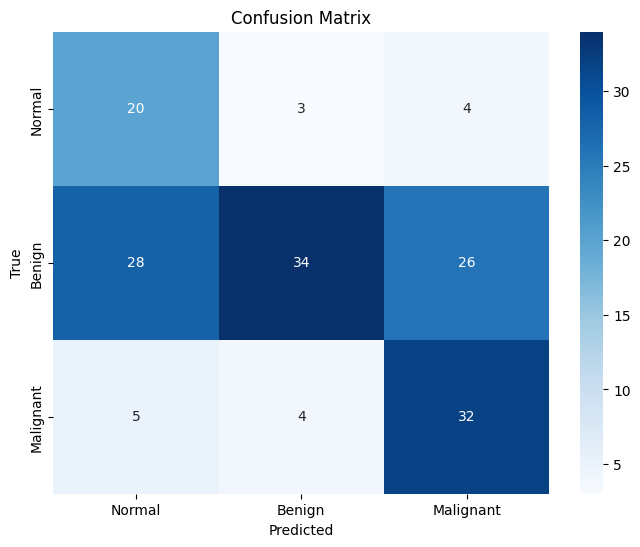

{'Precision_Normal': [0.71875,
  0.7058823529411765,
  0.7352941176470589,
  0.5333333333333333,
  0.7,
  0.2716049382716049,
  0.30985915492957744,
  0.4666666666666667],
 'Precision_Benign': [0.8588235294117647,
  0.8850574712643678,
  0.8648648648648649,
  0.8472222222222222,
  0.8433734939759037,
  0.75,
  0.7291666666666666,
  0.7647058823529411],
 'Precision_Malignant': [0.8205128205128205,
  0.8571428571428571,
  0.625,
  0.6923076923076923,
  0.6976744186046512,
  0.44776119402985076,
  0.6216216216216216,
  0.5517241379310345],
 'Recall_Normal': [0.8518518518518519,
  0.8888888888888888,
  0.9259259259259259,
  0.8888888888888888,
  0.7777777777777778,
  0.8148148148148148,
  0.8148148148148148,
  0.5185185185185185],
 'Recall_Benign': [0.8295454545454546,
  0.875,
  0.7272727272727273,
  0.6931818181818182,
  0.7954545454545454,
  0.06818181818181818,
  0.3977272727272727,
  0.5909090909090909],
 'Recall_Malignant': [0.7804878048780488,
  0.7317073170731707,
  0.7317073170731

In [ ]:
# Replace these with your actual y_true and y_pred
y_true = np.argmax(y_test_total_label,axis=1)
y_pred = np.argmax(y_pred_total,axis=1)

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot Confusion Matrix using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Normal', 'Benign', 'Malignant'],
            yticklabels=['Normal', 'Benign', 'Malignant'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# Precision and Recall DataFrame
try:
  precision_recall_data
except NameError:
  precision_recall_data = {'Precision_Normal': [], 'Precision_Benign': [], 'Precision_Malignant': [],
                           'Recall_Normal': [], 'Recall_Benign': [], 'Recall_Malignant': [],
                           'Recall_BM': [], 'model':[], 'train_loss':[],'val_loss':[]
                           }

class_map = {'Precision_Class_0':'Precision_Normal','Precision_Class_1':'Precision_Benign','Precision_Class_2':'Precision_Malignant',
             'Recall_Class_0':'Recall_Normal','Recall_Class_1':'Recall_Benign','Recall_Class_2':'Recall_Malignant'}

# Calculate precision and recall for each class
for i in range(np.max(y_true)+1):  # Assuming classes start from 0
    precision = precision_score(y_true, y_pred, labels=[i], average='micro')
    recall = recall_score(y_true, y_pred, labels=[i], average='micro')

    # Append precision and recall to the dictionary
    precision_recall_data[class_map[f'Precision_Class_{i}']].append(precision)
    precision_recall_data[class_map[f'Recall_Class_{i}']].append(recall)

precision_recall_data['Recall_BM'].append((precision_recall_data['Recall_Benign'][-1]+precision_recall_data['Recall_Malignant'][-1])/2)
precision_recall_data['train_loss'].append(history.history['loss'])
precision_recall_data['val_loss'].append(history.history['val_loss'])
precision_recall_data['model'].append(model)

In [ ]:
precision_recall_data['model']

['EfficientNetB7',
 'ResNet152V2',
 'VGG19',
 'EfficientNetV2S',
 'ConvNeXtBase',
 'vit_b16',
 'vit_b16',
 'vit_b16']

<Figure size 1800x1200 with 0 Axes>

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'EfficientNetB7')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'ResNet152V2')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'VGG19')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'EfficientNetV2S')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'ConvNeXtBase')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'vit_b16')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'vit_b16')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'vit_b16')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'Epoch')

Text(0, 0.5, 'Loss')

Text(0.5, 1.05, 'vit_b16')

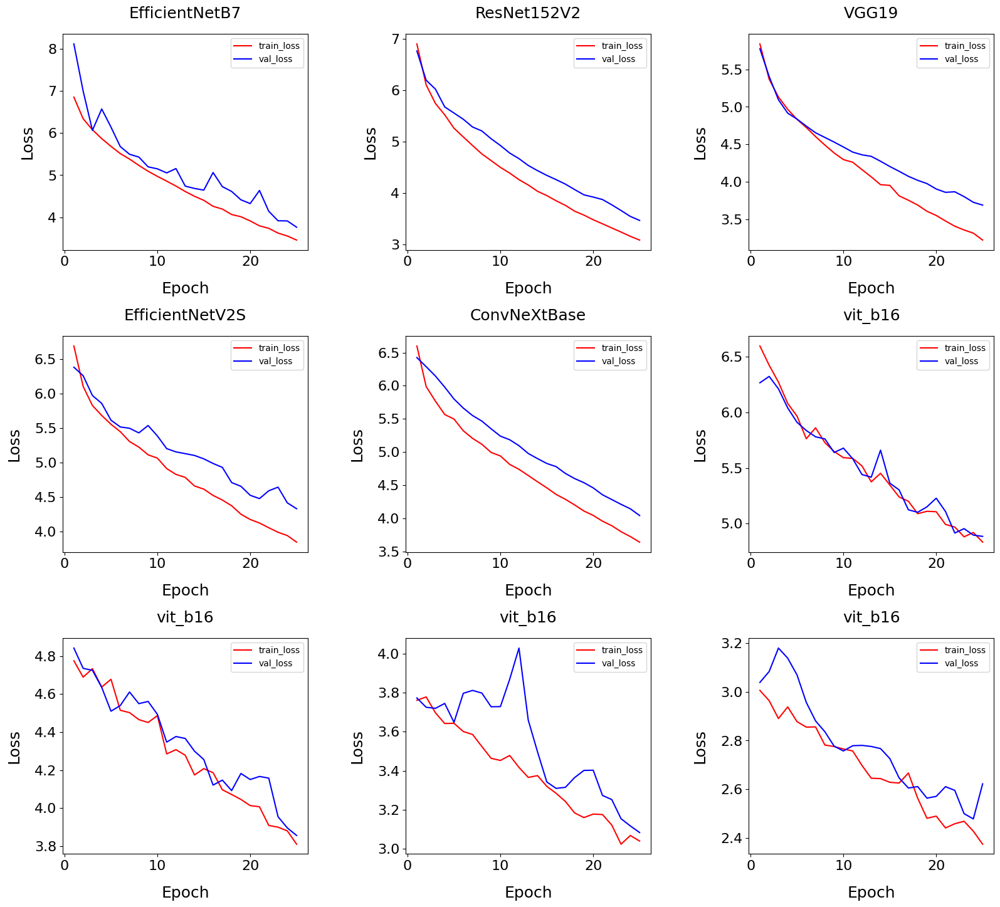

<Figure size 640x480 with 0 Axes>

In [ ]:
# Set the figure size
plt.figure(figsize=(18, 12))

for i in range(len(precision_recall_data['model'])):
    plt.subplot(3, 3, i+1)

    sns.lineplot(y=precision_recall_data['train_loss'][i], x=np.linspace(1, 25, 25), color='red', label='train_loss')
    sns.lineplot(y=precision_recall_data['val_loss'][i], x=np.linspace(1, 25, 25), color='blue', label='val_loss')

    plt.xlabel('Epoch', size=18, labelpad=15)
    plt.ylabel('Loss', size=18, labelpad=15)
    plt.tick_params(axis='x', labelsize=16)
    plt.tick_params(axis='y', labelsize=16)

    plt.legend()
    #plt.legend(['Train Loss', 'Validation Loss'], loc='upper center', prop={'size': 14})
    plt.title('{}'.format(precision_recall_data['model'][i]), size=18, y=1.05)

# Adjust layout
plt.subplots_adjust(right=0.95, top=1.2, hspace=0.4, wspace=0.4)

# Show the plot
plt.show()
plt.savefig('model_loss.png')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'epoch')

Text(0, 0.5, 'loss')

Text(0.5, 1.05, 'EfficientNetB7')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'epoch')

Text(0, 0.5, 'loss')

Text(0.5, 1.05, 'ResNet152V2')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'epoch')

Text(0, 0.5, 'loss')

Text(0.5, 1.05, 'VGG19')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'epoch')

Text(0, 0.5, 'loss')

Text(0.5, 1.05, 'EfficientNetV2S')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'epoch')

Text(0, 0.5, 'loss')

Text(0.5, 1.05, 'ConvNeXtBase')

<Axes: >

<Axes: >

<Axes: >

Text(0.5, 0, 'epoch')

Text(0, 0.5, 'loss')

Text(0.5, 1.05, 'vit_b16')

ValueError: ignored

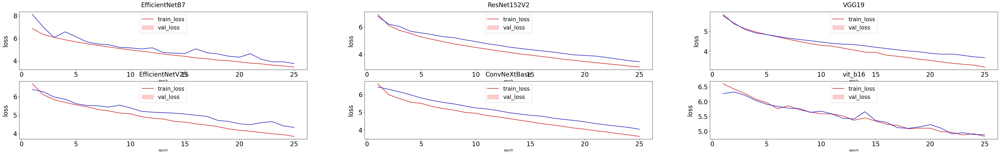

In [ ]:
#Plotting numerical_discrete_cols

fig, axs = plt.subplots(ncols=3, nrows=2, figsize=(10, 5))
plt.subplots_adjust(right=2.5, top=1.25)

for i in range(len(precision_recall_data['model'])):
    plt.subplot(2, 3, i+1)
    plt.subplots_adjust(right=4.5, top=1.25)

    sns.lineplot(y=precision_recall_data['train_loss'][i],x=np.linspace(1,25,25),color='red',label='train_loss')
    sns.lineplot(y=precision_recall_data['val_loss'][i],x=np.linspace(1,25,25),color='blue',label='val_loss')

    plt.xlabel('{}'.format('epoch'))
    plt.ylabel('loss', size=20, labelpad=15)
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)

    plt.legend(['train_loss', 'val_loss'], loc='upper center', prop={'size': 18})
    plt.title('{}'.format(precision_recall_data['model'][i]), size=20, y=1.05)

In [ ]:
precision_recall_data

{'Precision_Normal': [0.71875,
  0.7058823529411765,
  0.7352941176470589,
  0.5333333333333333,
  0.7,
  0.2716049382716049,
  0.30985915492957744,
  0.4666666666666667,
  0.37735849056603776],
 'Precision_Benign': [0.8588235294117647,
  0.8850574712643678,
  0.8648648648648649,
  0.8472222222222222,
  0.8433734939759037,
  0.75,
  0.7291666666666666,
  0.7647058823529411,
  0.8292682926829268],
 'Precision_Malignant': [0.8205128205128205,
  0.8571428571428571,
  0.625,
  0.6923076923076923,
  0.6976744186046512,
  0.44776119402985076,
  0.6216216216216216,
  0.5517241379310345,
  0.5161290322580645],
 'Recall_Normal': [0.8518518518518519,
  0.8888888888888888,
  0.9259259259259259,
  0.8888888888888888,
  0.7777777777777778,
  0.8148148148148148,
  0.8148148148148148,
  0.5185185185185185,
  0.7407407407407407],
 'Recall_Benign': [0.8295454545454546,
  0.875,
  0.7272727272727273,
  0.6931818181818182,
  0.7954545454545454,
  0.06818181818181818,
  0.3977272727272727,
  0.59090909090

In [ ]:
precision_recall_data = {'Precision_Normal': [0.71875,
  0.7058823529411765,
  0.7352941176470589,
  0.5333333333333333,
  0.7,
  0.2716049382716049,
  0.30985915492957744,
  0.4666666666666667,
  0.37735849056603776],
 'Precision_Benign': [0.8588235294117647,
  0.8850574712643678,
  0.8648648648648649,
  0.8472222222222222,
  0.8433734939759037,
  0.75,
  0.7291666666666666,
  0.7647058823529411,
  0.8292682926829268],
 'Precision_Malignant': [0.8205128205128205,
  0.8571428571428571,
  0.625,
  0.6923076923076923,
  0.6976744186046512,
  0.44776119402985076,
  0.6216216216216216,
  0.5517241379310345,
  0.5161290322580645],
 'Recall_Normal': [0.8518518518518519,
  0.8888888888888888,
  0.9259259259259259,
  0.8888888888888888,
  0.7777777777777778,
  0.8148148148148148,
  0.8148148148148148,
  0.5185185185185185,
  0.7407407407407407],
 'Recall_Benign': [0.8295454545454546,
  0.875,
  0.7272727272727273,
  0.6931818181818182,
  0.7954545454545454,
  0.06818181818181818,
  0.3977272727272727,
  0.5909090909090909,
  0.38636363636363635],
 'Recall_Malignant': [0.7804878048780488,
  0.7317073170731707,
  0.7317073170731707,
  0.6585365853658537,
  0.7317073170731707,
  0.7317073170731707,
  0.5609756097560976,
  0.7804878048780488,
  0.7804878048780488],
 'Recall_BM': [0.8050166297117517,
  0.8033536585365854,
  0.729490022172949,
  0.675859201773836,
  0.7635809312638581,
  0.3999445676274944,
  0.47935144124168516,
  0.6856984478935699,
  0.5834257206208426],
 'model': ['EfficientNetB7',
  'ResNet152V2',
  'VGG19',
  'EfficientNetV2S',
  'ConvNeXtBase',
  'vit_b16',
  'vit_b16',
  'vit_b16',
  'vit_b16'],
 'train_loss': [[6.854719161987305,
   6.340126991271973,
   6.079154968261719,
   5.867945194244385,
   5.684239864349365,
   5.512788772583008,
   5.381749153137207,
   5.232333660125732,
   5.09210729598999,
   4.971670150756836,
   4.857043743133545,
   4.740520477294922,
   4.610620021820068,
   4.49702787399292,
   4.401451110839844,
   4.258966445922852,
   4.193199634552002,
   4.063582897186279,
   4.0114336013793945,
   3.911395788192749,
   3.7945616245269775,
   3.735835075378418,
   3.6223509311676025,
   3.5535717010498047,
   3.4562103748321533],
  [6.905592918395996,
   6.109001159667969,
   5.747377395629883,
   5.52654504776001,
   5.2653608322143555,
   5.096477031707764,
   4.929220676422119,
   4.7662353515625,
   4.6361846923828125,
   4.50437593460083,
   4.392943382263184,
   4.265339374542236,
   4.161447048187256,
   4.038815975189209,
   3.9556782245635986,
   3.854999542236328,
   3.7656257152557373,
   3.6519575119018555,
   3.575829029083252,
   3.4851982593536377,
   3.406249523162842,
   3.325319766998291,
   3.2462992668151855,
   3.16296648979187,
   3.0898447036743164],
  [5.838052749633789,
   5.367259502410889,
   5.131017208099365,
   4.966387748718262,
   4.833348751068115,
   4.723948955535889,
   4.603078842163086,
   4.49120569229126,
   4.38524055480957,
   4.296921730041504,
   4.2616353034973145,
   4.1630377769470215,
   4.0664215087890625,
   3.9626667499542236,
   3.9530768394470215,
   3.814035177230835,
   3.755357027053833,
   3.6914050579071045,
   3.608325958251953,
   3.5522749423980713,
   3.478391647338867,
   3.409404754638672,
   3.359057664871216,
   3.3165619373321533,
   3.2243454456329346],
  [6.691906929016113,
   6.106658458709717,
   5.829651355743408,
   5.685358047485352,
   5.557446002960205,
   5.450863361358643,
   5.307675838470459,
   5.227036476135254,
   5.1151347160339355,
   5.066837310791016,
   4.915639400482178,
   4.8313422203063965,
   4.787936687469482,
   4.663686752319336,
   4.617891788482666,
   4.526740074157715,
   4.459323406219482,
   4.377296447753906,
   4.254397869110107,
   4.178125381469727,
   4.126935005187988,
   4.058690547943115,
   3.993025064468384,
   3.945188522338867,
   3.8498566150665283],
  [6.599625110626221,
   5.987334251403809,
   5.766733646392822,
   5.5649614334106445,
   5.4965081214904785,
   5.319969177246094,
   5.204734802246094,
   5.116312026977539,
   4.992335796356201,
   4.939850330352783,
   4.812477111816406,
   4.737867832183838,
   4.64453649520874,
   4.550068378448486,
   4.458279132843018,
   4.359259128570557,
   4.285268306732178,
   4.200531482696533,
   4.107911109924316,
   4.042120933532715,
   3.95501708984375,
   3.8866045475006104,
   3.796562433242798,
   3.7228996753692627,
   3.6386194229125977],
  [6.597210884094238,
   6.424031734466553,
   6.271888732910156,
   6.079944133758545,
   5.96674108505249,
   5.7630615234375,
   5.8611345291137695,
   5.728132724761963,
   5.648255825042725,
   5.592635154724121,
   5.586394309997559,
   5.518782615661621,
   5.374928951263428,
   5.452523708343506,
   5.346946716308594,
   5.239167213439941,
   5.20088005065918,
   5.088810920715332,
   5.110340595245361,
   5.106450080871582,
   4.9921956062316895,
   4.968846797943115,
   4.880895614624023,
   4.919295787811279,
   4.832883834838867],
  [4.775277137756348,
   4.6891188621521,
   4.733670234680176,
   4.637033939361572,
   4.67797327041626,
   4.515038013458252,
   4.502705097198486,
   4.465878486633301,
   4.450704574584961,
   4.4868292808532715,
   4.285569190979004,
   4.307886123657227,
   4.278515338897705,
   4.174790382385254,
   4.208048343658447,
   4.1868577003479,
   4.097017765045166,
   4.072070598602295,
   4.046131134033203,
   4.01377534866333,
   4.007629871368408,
   3.909381628036499,
   3.9002485275268555,
   3.88069224357605,
   3.8107523918151855],
  [3.761373996734619,
   3.778421640396118,
   3.6970551013946533,
   3.6420373916625977,
   3.6432197093963623,
   3.6010942459106445,
   3.5859296321868896,
   3.524191379547119,
   3.4635539054870605,
   3.452605724334717,
   3.478113889694214,
   3.417020082473755,
   3.365612745285034,
   3.3748087882995605,
   3.319640636444092,
   3.2841827869415283,
   3.2423551082611084,
   3.1833579540252686,
   3.15948224067688,
   3.1774134635925293,
   3.17508864402771,
   3.121107339859009,
   3.0229506492614746,
   3.067593812942505,
   3.0391194820404053],
  [3.006199359893799,
   2.9637210369110107,
   2.8904194831848145,
   2.9381818771362305,
   2.87762713432312,
   2.8550994396209717,
   2.8559958934783936,
   2.7814269065856934,
   2.775334119796753,
   2.7652196884155273,
   2.757004499435425,
   2.697538375854492,
   2.6449739933013916,
   2.6434056758880615,
   2.6282453536987305,
   2.6250882148742676,
   2.666353225708008,
   2.56327748298645,
   2.4802896976470947,
   2.4891600608825684,
   2.4404685497283936,
   2.4577908515930176,
   2.4680254459381104,
   2.427126884460449,
   2.373706579208374]],
 'val_loss': [[8.119131088256836,
   6.999160289764404,
   6.064292907714844,
   6.573341369628906,
   6.141852855682373,
   5.678971290588379,
   5.496169567108154,
   5.429867267608643,
   5.19749116897583,
   5.149529457092285,
   5.053578853607178,
   5.1560773849487305,
   4.739144802093506,
   4.683670997619629,
   4.643535137176514,
   5.0617995262146,
   4.726529598236084,
   4.612680912017822,
   4.413448810577393,
   4.324687480926514,
   4.635236740112305,
   4.140691757202148,
   3.915515899658203,
   3.911458730697632,
   3.7621190547943115],
  [6.769429683685303,
   6.1992363929748535,
   6.026618957519531,
   5.680245876312256,
   5.560941696166992,
   5.44075345993042,
   5.289792537689209,
   5.212464332580566,
   5.061533451080322,
   4.930054664611816,
   4.782619476318359,
   4.674489498138428,
   4.541243553161621,
   4.440645694732666,
   4.3482489585876465,
   4.265987396240234,
   4.178748607635498,
   4.072357654571533,
   3.969897985458374,
   3.9265642166137695,
   3.8784339427948,
   3.775819778442383,
   3.664708137512207,
   3.549970865249634,
   3.472172260284424],
  [5.772852420806885,
   5.404664039611816,
   5.093433380126953,
   4.915322780609131,
   4.836726665496826,
   4.742763996124268,
   4.653926849365234,
   4.592113018035889,
   4.530151844024658,
   4.464447975158691,
   4.396873950958252,
   4.360544681549072,
   4.340058326721191,
   4.27472448348999,
   4.2048492431640625,
   4.141259670257568,
   4.074030876159668,
   4.0208516120910645,
   3.9772839546203613,
   3.9048492908477783,
   3.860644578933716,
   3.867934465408325,
   3.803788423538208,
   3.7277655601501465,
   3.690154552459717],
  [6.3844451904296875,
   6.261341094970703,
   5.974192142486572,
   5.860472679138184,
   5.617295265197754,
   5.518880367279053,
   5.4997100830078125,
   5.433023452758789,
   5.539575576782227,
   5.388551712036133,
   5.204887390136719,
   5.157576084136963,
   5.132103443145752,
   5.10573148727417,
   5.056684970855713,
   4.989657878875732,
   4.933071613311768,
   4.7130537033081055,
   4.658967018127441,
   4.528752326965332,
   4.480550765991211,
   4.594090461730957,
   4.6465864181518555,
   4.418946266174316,
   4.333854675292969],
  [6.4248762130737305,
   6.287235736846924,
   6.146008491516113,
   5.978724002838135,
   5.7992472648620605,
   5.662476539611816,
   5.54922342300415,
   5.466011047363281,
   5.349093914031982,
   5.238687992095947,
   5.184336185455322,
   5.094578266143799,
   4.977065086364746,
   4.899270534515381,
   4.826159477233887,
   4.7785563468933105,
   4.676028251647949,
   4.598038196563721,
   4.536171913146973,
   4.457434177398682,
   4.353241920471191,
   4.281606197357178,
   4.209352970123291,
   4.141651153564453,
   4.040046691894531],
  [6.266345024108887,
   6.3236284255981445,
   6.211763381958008,
   6.039879322052002,
   5.91074275970459,
   5.836934566497803,
   5.780356407165527,
   5.761749267578125,
   5.639089107513428,
   5.678475856781006,
   5.583357810974121,
   5.440768718719482,
   5.417189598083496,
   5.660155296325684,
   5.363264560699463,
   5.302829265594482,
   5.12337064743042,
   5.101515769958496,
   5.150460720062256,
   5.228195667266846,
   5.1083598136901855,
   4.914844989776611,
   4.954263210296631,
   4.896031856536865,
   4.88466215133667],
  [4.842202663421631,
   4.73561429977417,
   4.724944591522217,
   4.635416030883789,
   4.510015964508057,
   4.5399017333984375,
   4.61105489730835,
   4.5497636795043945,
   4.561446666717529,
   4.493518352508545,
   4.347328186035156,
   4.376978397369385,
   4.366718292236328,
   4.299890995025635,
   4.256234645843506,
   4.1215386390686035,
   4.147742748260498,
   4.0926103591918945,
   4.182620525360107,
   4.150834083557129,
   4.166965007781982,
   4.158196926116943,
   3.955420970916748,
   3.8964037895202637,
   3.8566954135894775],
  [3.773350238800049,
   3.7254655361175537,
   3.7200605869293213,
   3.7451562881469727,
   3.6481385231018066,
   3.7970118522644043,
   3.8120856285095215,
   3.7983295917510986,
   3.7279937267303467,
   3.72888445854187,
   3.8691089153289795,
   4.029284954071045,
   3.6596553325653076,
   3.4968652725219727,
   3.342233180999756,
   3.309343099594116,
   3.314645528793335,
   3.364776611328125,
   3.401470184326172,
   3.402467727661133,
   3.2731077671051025,
   3.251889944076538,
   3.1535511016845703,
   3.1166694164276123,
   3.0827455520629883],
  [3.0389435291290283,
   3.0839016437530518,
   3.180269479751587,
   3.138461112976074,
   3.0697567462921143,
   2.956798791885376,
   2.8806068897247314,
   2.836263418197632,
   2.776798725128174,
   2.7570834159851074,
   2.778658628463745,
   2.779991626739502,
   2.775622844696045,
   2.7667829990386963,
   2.725902795791626,
   2.6462275981903076,
   2.6047816276550293,
   2.6105947494506836,
   2.5630061626434326,
   2.5703673362731934,
   2.610185384750366,
   2.5951082706451416,
   2.4992899894714355,
   2.477642774581909,
   2.6219482421875]]}

In [ ]:
# Create a DataFrame with the index as the model name
precision_recall_df = pd.DataFrame(precision_recall_data)
print("\nPrecision and Recall DataFrame:")
precision_recall_df
#precision_recall_df.applymap(lambda x:round(x,2))


Precision and Recall DataFrame:


,Precision_Normal,Precision_Benign,Precision_Malignant,Recall_Normal,Recall_Benign,Recall_Malignant,Recall_BM,model,train_loss,val_loss
0,0.718750,0.858824,0.820513,0.851852,0.829545,0.780488,0.805017,EfficientNetB7,"[6.854719161987305, 6.340126991271973, 6.07915...","[8.119131088256836, 6.999160289764404, 6.06429..."
1,0.705882,0.885057,0.857143,0.888889,0.875000,0.731707,0.803354,ResNet152V2,"[6.905592918395996, 6.109001159667969, 5.74737...","[6.769429683685303, 6.1992363929748535, 6.0266..."
2,0.735294,0.864865,0.625000,0.925926,0.727273,0.731707,0.729490,VGG19,"[5.838052749633789, 5.367259502410889, 5.13101...","[5.772852420806885, 5.404664039611816, 5.09343..."
3,0.533333,0.847222,0.692308,0.888889,0.693182,0.658537,0.675859,EfficientNetV2S,"[6.691906929016113, 6.106658458709717, 5.82965...","[6.3844451904296875, 6.261341094970703, 5.9741..."
4,0.700000,0.843373,0.697674,0.777778,0.795455,0.731707,0.763581,ConvNeXtBase,"[6.599625110626221, 5.987334251403809, 5.76673...","[6.4248762130737305, 6.287235736846924, 6.1460..."
5,0.271605,0.750000,0.447761,0.814815,0.068182,0.731707,0.399945,vit_b16,"[6.597210884094238, 6.424031734466553, 6.27188...","[6.266345024108887, 6.3236284255981445, 6.2117..."
6,0.309859,0.729167,0.621622,0.814815,0.397727,0.560976,0.479351,vit_b16,"[4.775277137756348, 4.6891188621521, 4.7336702...","[4.842202663421631, 4.73561429977417, 4.724944..."
7,0.466667,0.764706,0.551724,0.518519,0.590909,0.780488,0.685698,vit_b16,"[3.761373996734619, 3.778421640396118, 3.69705...","[3.773350238800049, 3.7254655361175537, 3.7200..."
8,0.377358,0.829268,0.516129,0.740741,0.386364,0.780488,0.583426,vit_b16,"[3.006199359893799, 2.9637210369110107, 2.8904...","[3.0389435291290283, 3.0839016437530518, 3.180..."


In [ ]:
precision_recall_df.applymap(lambda x: round(x,2) if type(x)==float else x)

,Precision_Normal,Precision_Benign,Precision_Malignant,Recall_Normal,Recall_Benign,Recall_Malignant,Recall_BM,model,train_loss,val_loss
0,0.72,0.86,0.82,0.85,0.83,0.78,0.81,EfficientNetB7,"[6.854719161987305, 6.340126991271973, 6.07915...","[8.119131088256836, 6.999160289764404, 6.06429..."
1,0.71,0.89,0.86,0.89,0.88,0.73,0.80,ResNet152V2,"[6.905592918395996, 6.109001159667969, 5.74737...","[6.769429683685303, 6.1992363929748535, 6.0266..."
2,0.74,0.86,0.62,0.93,0.73,0.73,0.73,VGG19,"[5.838052749633789, 5.367259502410889, 5.13101...","[5.772852420806885, 5.404664039611816, 5.09343..."
3,0.53,0.85,0.69,0.89,0.69,0.66,0.68,EfficientNetV2S,"[6.691906929016113, 6.106658458709717, 5.82965...","[6.3844451904296875, 6.261341094970703, 5.9741..."
4,0.70,0.84,0.70,0.78,0.80,0.73,0.76,ConvNeXtBase,"[6.599625110626221, 5.987334251403809, 5.76673...","[6.4248762130737305, 6.287235736846924, 6.1460..."


In [ ]:
np.argmax(y_pred_total,axis=1)
y_test_total_label
y_pred_total

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 1, 0, 1, 1,
       1, 1, 0, 1, 1, 2, 1, 2, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2,
       2, 2, 1, 1, 1, 2, 1, 1, 2, 2, 1, 1, 2, 1, 1, 2, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 2, 2, 1, 1, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 2, 1, 1,
       1, 1])

array([[0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 0, 1],
       [0, 1, 0],
       [0, 0, 1],
       [0, 0, 1],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 1, 0],
       [0, 0, 1],
       [0, 1, 0],
       [1, 0, 0],
       [1, 0, 0],
       [1, 0, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [1, 0, 0],
       [1, 0, 0],
       [0, 0, 1],
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       [0, 0, 1],
       [1, 0, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0,

array([[0.15433636, 0.79106706, 0.05459654],
       [0.3265916 , 0.37611356, 0.29729486],
       [0.06424157, 0.74761975, 0.18813877],
       [0.2950921 , 0.6519049 , 0.05300295],
       [0.05661095, 0.86344177, 0.07994732],
       [0.14961874, 0.6548916 , 0.19548963],
       [0.04006509, 0.7266401 , 0.23329474],
       [0.20115954, 0.6269599 , 0.17188056],
       [0.08412061, 0.8120553 , 0.10382413],
       [0.08539028, 0.88726324, 0.02734649],
       [0.03650925, 0.70229965, 0.26119107],
       [0.14229658, 0.7170406 , 0.14066279],
       [0.02569895, 0.89693886, 0.0773622 ],
       [0.6325256 , 0.27785295, 0.08962145],
       [0.08679474, 0.41571912, 0.4974861 ],
       [0.04672735, 0.62830704, 0.32496554],
       [0.19470887, 0.6321204 , 0.17317075],
       [0.02481234, 0.8819685 , 0.09321913],
       [0.16084573, 0.5641676 , 0.2749867 ],
       [0.13434942, 0.77237016, 0.0932804 ],
       [0.08655578, 0.465469  , 0.44797522],
       [0.17533271, 0.6284037 , 0.19626355],
       [0.

In [ ]:
y_pred_total = model.predict(dataset_test, verbose=1)

130/130 [==============================] - 1s 4ms/step


TypeError: ignored

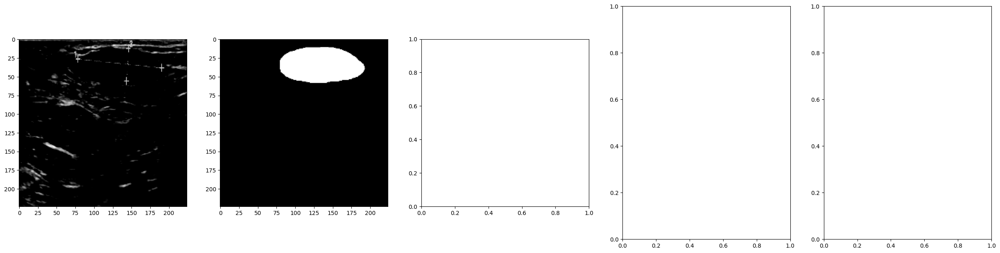

In [ ]:
explainer = GradCAM()
def plotter(images, masks, predicted_images, n):
    for i in range(n):
        fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(10, 5))
        plt.subplots_adjust(right=2.5, top=1.25)
        axs[0].imshow(images[i])
        axs[1].imshow(masks[i])
        #axs[2].imshow(predicted_images[i])
        axs[2].imshow(predicted_images[i] > 0.4)
        axs[3].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2_wgt',class_index=1),cmap='gray')
        #axs[4].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2_wgt',class_index=3),cmap='gray')

        #axs[3].imshow(explainer.explain((images[i],masks[i]), model, layer_name = 'conv2d_16',class_index=1))
        #.astype(int)
        plt.show()


plotter(X_test_total,y_test_total,y_pred_total,5)
#plotter(X_train_total,y_train_total,y_pred_total,20)

In [ ]:
!pip install streamlit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 21.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.3 MB/s eta 0:00:00
  Attempting uninstall: importlib-metadata
    Found existing installation: importlib-metadata 7.0.0
    Uninstalling importlib-metadata-7.0.0:
      Successfully uninstalled importlib-metadata-7.0.0


In [ ]:
import tensorflow as tf
loaded_model = tf.keras.models.load_model('Detection_model', custom_objects={'recall_c0':recall_c0,'recall_c1':recall_c1,'recall_c2':recall_c2,
                                                                             'precision_c0':precision_c0,'precision_c1':precision_c1,'precision_c2':precision_c2})

NameError: ignored

In [ ]:
loaded_model

In [ ]:
test_img = load_image(path = 'Dataset_BUSI_with_GT/malignant/malignant (90).png', size = config.SIZE, model = 'EfficientNetB7')

In [ ]:
test_img = np.expand_dims(test_img, axis=0)


In [ ]:
test_img.shape

(1, 224, 224, 3)

In [ ]:
pred = loaded_model.predict(test_img)
pred
np.argmax(pred,axis=1)[0]

1/1 [==============================] - 0s 410ms/step


array([[2.1402857e-04, 2.6177975e-06, 9.9978334e-01]], dtype=float32)

2

In [ ]:
loaded_model.summary()
loaded_model.get_layer('efficientnetb7').summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb7 (Functional  (None, 2560)              64097687  
 )                                                               
                                                                 
 flatten (Flatten)           (None, 2560)              0         
                                                                 
 dense (Dense)               (None, 256)               655616    
                                                                 
 batch_normalization (Batch  (None, 256)               1024      
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 256)               0     

KeyboardInterrupt: ignored

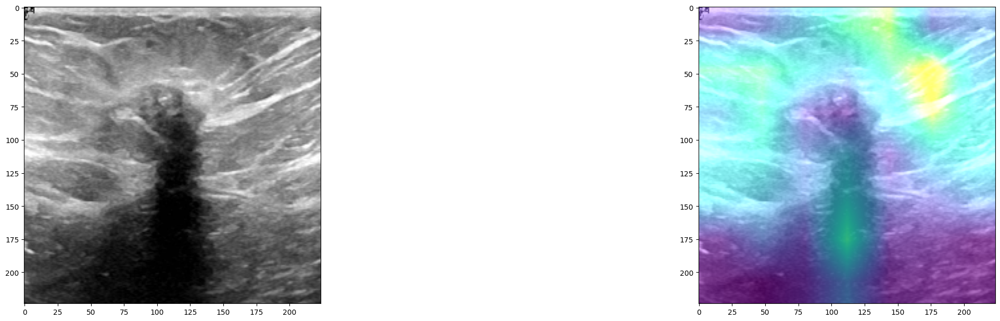

In [ ]:
explainer = GradCAM()
def plotter(images, layer = 'top_activation'):

    fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)
    axs[0].imshow(test_img[0,...])
    #axs[1].imshow(test_img[0,...])
    #axs[2].imshow(predicted_images[i])
    #axs[2].imshow(predicted_images[i] > 0.4)
    #axs[1].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2_wgt',class_index=1),cmap='gray')
    axs[1].imshow(explainer.explain((test_img,test_img[0,...]),
                                    loaded_model.get_layer('efficientnetb7'),
                                    layer_name = 'top_activation',
                                    class_index=1,
                                    image_weight=0.70))
    #,cmap='gray')

    #axs[3].imshow(explainer.explain((images[i],masks[i]), model, layer_name = 'conv2d_16',class_index=1))
    #.astype(int)
    plt.show()

plotter(test_img)

In [ ]:
explainer = GradCAM()
def plotter(images, masks, predicted_images, n):
    for i in range(n):
        fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(10, 5))
        plt.subplots_adjust(right=2.5, top=1.25)
        axs[0].imshow(images[i])
        axs[1].imshow(masks[i])
        #axs[2].imshow(predicted_images[i])
        axs[2].imshow(predicted_images[i] > 0.4)
        #axs[3].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2_wgt',class_index=1),cmap='gray')
        axs[4].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'top_activation',class_index=3),cmap='gray')

        #axs[3].imshow(explainer.explain((images[i],masks[i]), model, layer_name = 'conv2d_16',class_index=1))
        #.astype(int)
        plt.show()


plotter(X_test_total,y_test_total,y_pred_total,5)

In [ ]:
%%writefile paths.py

class Paths:
  def __init__(self):
    self.DETECTION_MODEL = 'Detection_model'
    self.SEGMENTATION_MODEL   = None
    self.DEFAULT_DETECTION_IMAGE = 'Dataset_BUSI_with_GT/malignant/malignant (90).png'
    self.DEFAULT_DETECTION_GRADCAM_IMAGE = 'Dataset_BUSI_with_GT/malignant/malignant (90).png'


if __name__=='__main__':
  pass

paths = Paths()

Overwriting paths.py


In [ ]:

paths.DETECTION_MODEL

'Detection_model'

In [ ]:
!pip install pathlib

In [ ]:
%%writefile app.py
import os
import streamlit as st
import PIL
import sys
import tensorflow as tf

st.set_page_config(
    page_title = 'AI Brain tumour Detection and Segmentation',
    layout = 'wide',
    initial_sidebar_state = 'expanded'
    )

st.title('AI Brain tumour Detection and Segmentation')
st.sidebar.header('ML model')

model_type = st.sidebar.radio("Select Task", ['Detection', 'Segmentation'])

if model_type == 'Detection':
  model_path = paths.DETECTION_MODEL
  custom_objects = {'recall_c0':recall_c0,'recall_c1':recall_c1,'recall_c2':recall_c2,
                    'precision_c0':precision_c0,'precision_c1':precision_c1,'precision_c2':precision_c2}

elif model_type == 'Segmentation':
  model_path = paths.SEGMENTATION_MODEL

try:
  model = tf.keras.models.load_model(model_path,custom_objects=custom_objects)
except Exception as ex:
  st.error(f'Unable to load the pretrained model with weight at {model_path}')
  st.error(ex)

source_radio = st.sidebar.radio("Select source", ['radio1','radio2'])
source_img = None

if model_type == 'Detection':
  col1, col2 = st.columns(2)
  source_img = st.sidebar.file_uploader('Choose an image...', type=('jpg','jpeg','png'))
  with col1:
    try:
      if source_img is None:
        uploaded_image = PIL.Image.open(paths.DEFAULT_DETECTION_IMAGE)
        st.image(uploaded_image,
                 caption='Example MRI Scan',
                 use_column_width=True
                )
      else:
        uploaded_image = PIL.Image.open(source_img)
        st.image(source_img,
                 caption='Uploaded MRI Scan',
                 use_column_width=True
                )
    except Exception as ex:
        st.error('Error occurred while opening the image.')
        st.error(ex)
  with col2:
    try:
      if source_img is None:
        uploaded_image = PIL.Image.open(paths.DEFAULT_DETECTION_GRADCAM_IMAGE)
        st.image(uploaded_image,
                 caption='Example Model Insights',
                 use_column_width=True
                )
      else:
        uploaded_image = PIL.Image.open(source_img)
        st.image(source_img,
                 caption='',
                 use_column_width=True
                )
    except Exception as ex:
        st.error('Error occurred while opening the image.')
        st.error(ex)





Overwriting app.py


In [ ]:
!npm install localtunnel

npm WARN saveError ENOENT: no such file or directory, open '/content/package.json'
npm notice created a lockfile as package-lock.json. You should commit this file.
npm WARN enoent ENOENT: no such file or directory, open '/content/package.json'
npm WARN content No description
npm WARN content No repository field.
npm WARN content No README data
npm WARN content No license field.

+ localtunnel@2.0.2
added 22 packages from 22 contributors and audited 22 packages in 2.629s

3 packages are looking for funding
  run `npm fund` for details

found 1 moderate severity vulnerability
  run `npm audit fix` to fix them, or `npm audit` for details


In [ ]:
!streamlit run /content/app.py &>/content/logs.txt &

In [ ]:
!npx localtunnel --port 8501

npx: installed 22 in 3.285s
your url is: https://huge-rooms-ask.loca.lt
^C


In [ ]:
!wget -q -O - ipv4.icanhazip.com

34.125.223.23


In [ ]:
tf.keras.backend.clear_session()

def augmentation_layer(x):
    x = tf.keras.layers.RandomFlip(input_shape=(
                                  config.HEIGHT,
                                  config.WIDTH,
                                  config.DEPTH) seed=config.SEED)(x)
    x = tf.keras.layers.RandomBrightness(0.0004,seed=config.SEED)(x)
    x = tf.keras.layers.RandomZoom(0.01,seed=config.SEED)(x)
    x = tf.keras.layers.RandomContrast(0.2,seed=config.SEED)(x)
    x = tf.keras.layers.RandomTranslation(height_factor=0.05,width_factor=0.05,seed=config.SEED)(x)
    x = tf.keras.layers.RandomRotation(0.05,seed=config.SEED)(x)

    return x

def double_conv_block(x, n_filters):

   # Conv2D then ReLU activation
   x = tf.keras.layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
   # Conv2D then ReLU activation
   x = tf.keras.layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)

   return x

def downsample_block(x, n_filters):
   f = double_conv_block(x, n_filters)
   p = tf.keras.layers.MaxPool2D(2)(f)
   p = tf.keras.layers.Dropout(0.3)(p)

   return f, p

def upsample_block(x, conv_features, n_filters):
   # upsample
   x = tf.keras.layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
   # concatenate
   x = tf.keras.layers.concatenate([x, conv_features])
   # dropout
   x = tf.keras.layers.Dropout(0.3)(x)
   # Conv2D twice with ReLU activation
   x = double_conv_block(x, n_filters)

   return x

def build_unet_model():
     # inputs
   inputs = tf.keras.layers.Input(shape=(256,256,1))

   #aug_inputs = augmentation_layer(inputs)

   # encoder: contracting path - downsample
   # 1 - downsample
   f1, p1 = downsample_block(inputs, 64)
   # 2 - downsample
   f2, p2 = downsample_block(p1, 128)
   # 3 - downsample
   f3, p3 = downsample_block(p2, 256)
   # 4 - downsample
   f4, p4 = downsample_block(p3, 512)

   # 5 - bottleneck
   bottleneck = double_conv_block(p4, 1024)

   # decoder: expanding path - upsample
   # 6 - upsample
   u6 = upsample_block(bottleneck, f4, 512)
   # 7 - upsample
   u7 = upsample_block(u6, f3, 256)
   # 8 - upsample
   u8 = upsample_block(u7, f2, 128)
   # 9 - upsample
   u9 = upsample_block(u8, f1, 64)

   # outputs
   outputs = tf.keras.layers.Conv2D(1, (1,1), padding="same", activation = "sigmoid")(u9)

   # unet model with Keras Functional API
   unet_model = tf.keras.Model(inputs, outputs, name="U-Net")

   return unet_model

model = build_unet_model()
tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)
model.summary()

SyntaxError: ignored

In [ ]:
# Custom loss function
def metric_dice():
  def dice_coef(y_true, y_pred):
      smooth = 1.
      y_true_f = K.flatten(y_true)
      y_pred_f = K.flatten(y_pred)
      intersection = K.sum(y_true_f * y_pred_f)
      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
      return dice
  return dice_coef

def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def dice_coef_logloss(y_true, y_pred):
    return -K.log(dice_coef(y_true, y_pred))

def bce_dice_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def dice_coef_multilabel(y_true, y_pred, M, smooth):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth)
    return dice

def dice_coef_multilabel(y_true, y_pred, M, smooth_list):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth_list[index])
    return dice

def metric_meaniou(thres=0.4):
  def metric(y_true,y_pred):
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    smooth=0
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    mean_iou = K.mean((intersection + smooth) / (union + smooth))
    return mean_iou
  return metric

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LR),
                   #loss=dice_coef_loss,
                   loss=tf.keras.losses.BinaryCrossentropy(),
                   #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
                   metrics = [metric_meaniou(),metric_dice()])
#binary cross entropy
NUM_EPOCHS=15

In [ ]:
import numpy
# learning rate
LR = 0.001
# Custom loss function
def metric_dice():
  def dice_coef(y_true, y_pred):
      smooth = 1.
      y_true_f = K.flatten(y_true)
      y_pred_f = K.flatten(y_pred)
      intersection = K.sum(y_true_f * y_pred_f)
      dice = (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
      return dice
  return dice_coef

def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def dice_coef_logloss(y_true, y_pred):
    return -K.log(dice_coef(y_true, y_pred))

def bce_dice_loss(y_true, y_pred):
    return 0.5 * tf.keras.losses.binary_crossentropy(y_true, y_pred) - dice_coef(y_true, y_pred)

def dice_coef_multilabel(y_true, y_pred, M, smooth):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth)
    return dice

def dice_coef_multilabel(y_true, y_pred, M, smooth_list):
    dice = 0
    for index in range(M):
        dice += dice_coef(y_true[:,:,:,index], y_pred[:,:,:,index], smooth_list[index])
    return dice

# Custom IoU metric
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)

def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3]) + K.sum(y_pred,[1,2,3]) - intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

def metric_meaniou(thres=0.4):
  def metric(y_true,y_pred):
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    smooth=0
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    mean_iou = K.mean((intersection + smooth) / (union + smooth))
    #print(f'metric_meaniou: {mean_iou.numpy()}')  # Print the value
    return mean_iou
    #return tf.keras.metrics.sparse_categorical_accuracy(yTrue, yPred)
  return metric

class Meaniou(tf.keras.metrics.Metric):

  def __init__(self, name='mean_iou', **kwargs):
    super().__init__(name=name, **kwargs)
    self.mean_iou = 0

  def update_state(self, y_true, y_pred, sample_weight=None):
    #y_true = tf.cast(y_true, tf.bool)
    #y_pred = tf.cast(y_pred, tf.bool)
    y_pred = tf.cast((y_pred > 0.4),tf.float32)
    #print(y_pred)
    #print(y_true)
    smooth=0
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f)  - intersection
    self.mean_iou = K.mean((intersection + smooth) / (union + smooth))
    print(f'metric_meaniou in custom: {self.mean_iou.numpy()}')  # Print the value
    #print(self.mean_iou)

  def result(self):
    return self.mean_iou

  def reset_state(self):
    self.mean_iou+=self.mean_iou


model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LR),
                   #loss=dice_coef_loss,
                   loss=tf.keras.losses.BinaryCrossentropy(),
                   #metrics = [metric_meaniou(),tf.keras.metrics.BinaryIoU(name='IoU')],
                   metrics = [metric_meaniou(),metric_dice()])
                   #run_eagerly=True)
#binary cross entropy
NUM_EPOCHS=15


In [ ]:
model.load_weights('best_model.hdf5', skip_mismatch=False, by_name=False, options=None)

In [ ]:


checkpoint = ModelCheckpoint('best_model.hdf5' ,
                             monitor = 'val_loss',
                             verbose = 1,
                             save_best_only=True,
                             mode = 'min',
                             save_weights_only=True,
                             save_freq='epoch'
                            )
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.3,
                              patience=15, min_lr=0.00005)

callbacks_list = [checkpoint, reduce_lr]

# Fit model
history = model.fit(dataset_train,
                    validation_data=dataset_test,
                    #steps_per_epoch=len(X_train)/(6),
                    #validation_steps=10,
                    callbacks=callbacks_list,
                    epochs=NUM_EPOCHS,
                    #verbose=2,
                    )

Epoch 1/15
29/29 [==============================] - ETA: 0s - loss: 0.2782 - metric: 0.6650 - dice_coef: 0.3952
Epoch 1: val_loss improved from inf to 0.32211, saving model to best_model.hdf5
29/29 [==============================] - 11s 375ms/step - loss: 0.2782 - metric: 0.6650 - dice_coef: 0.3952 - val_loss: 0.3221 - val_metric: 0.4524 - val_dice_coef: 0.2590 - lr: 0.0010
Epoch 2/15
29/29 [==============================] - ETA: 0s - loss: 0.2705 - metric: 0.6715 - dice_coef: 0.4044
Epoch 2: val_loss improved from 0.32211 to 0.31114, saving model to best_model.hdf5
29/29 [==============================] - 11s 379ms/step - loss: 0.2705 - metric: 0.6715 - dice_coef: 0.4044 - val_loss: 0.3111 - val_metric: 0.5281 - val_dice_coef: 0.2641 - lr: 0.0010
Epoch 3/15
29/29 [==============================] - ETA: 0s - loss: 0.2624 - metric: 0.6828 - dice_coef: 0.4124
Epoch 3: val_loss did not improve from 0.31114
29/29 [==============================] - 11s 372ms/step - loss: 0.2624 - metric: 0.

In [ ]:

#pip install tf-explain
from tf_explain.core.grad_cam import GradCAM


In [ ]:
X_test_total[0].shape
model.get_layer('conv2d_18')

(256, 256, 1)

In [ ]:
explainer = GradCAM()
explainer.explain((np.expand_dims(X_test_total[0], 0),y_test_total[0]), model, layer_name = 'conv2d_18',class_index=1).shape

(256, 256, 3)

In [ ]:
unet_model.save_weights('weights', overwrite=True, save_format=None, options=None)

In [ ]:
unet_model.load_weights('best_model.hdf5', skip_mismatch=False, by_name=False, options=None)


ValueError: ignored

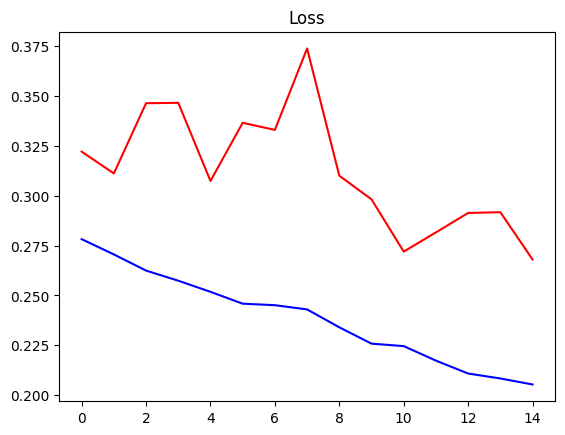

In [ ]:
def plot_loss_history(history):
    # validation losses
    val_loss = history.history['val_loss']
    loss = history.history['loss']

    plt.title('Loss')
    plt.plot(val_loss, 'r', loss, 'b')
    plt.show()

plot_loss_history(history)

In [ ]:
y_pred_total[0].shape

(256, 256, 1)

In [ ]:
y_pred_total = model.predict(dataset_test, verbose=1)

195/195 [==============================] - 1s 8ms/step


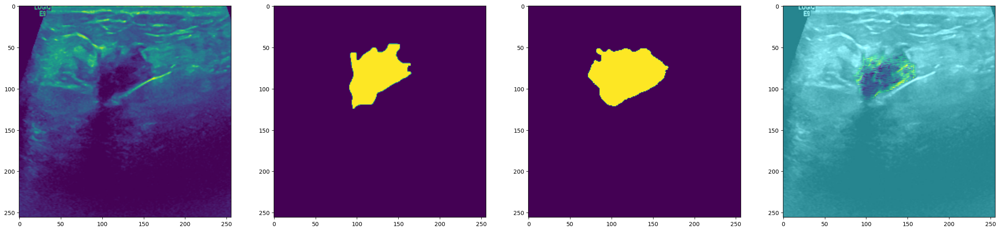

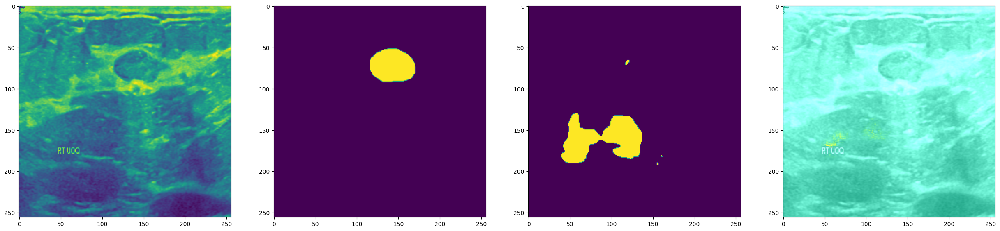

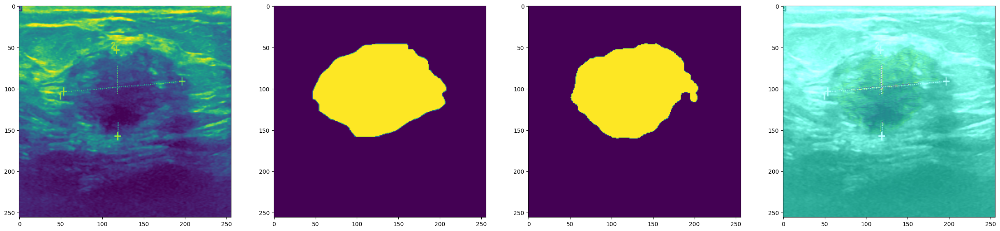

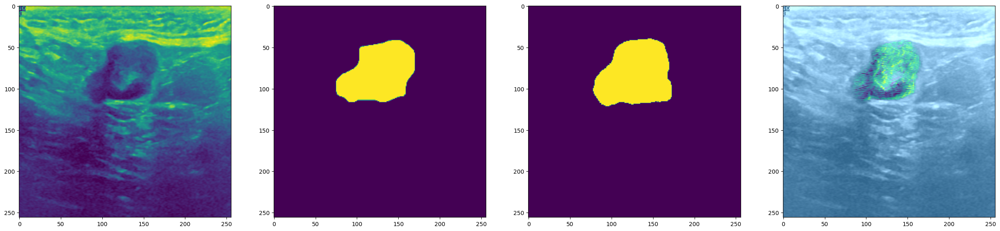

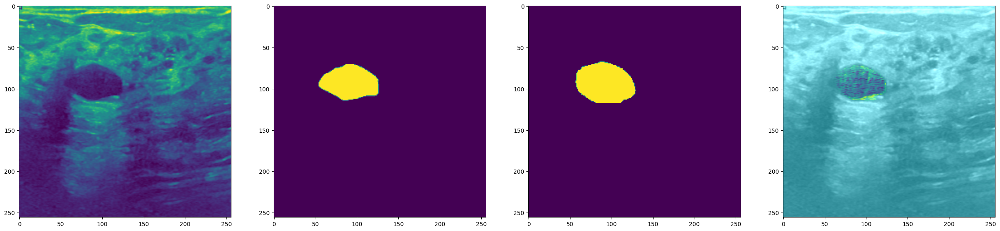

...

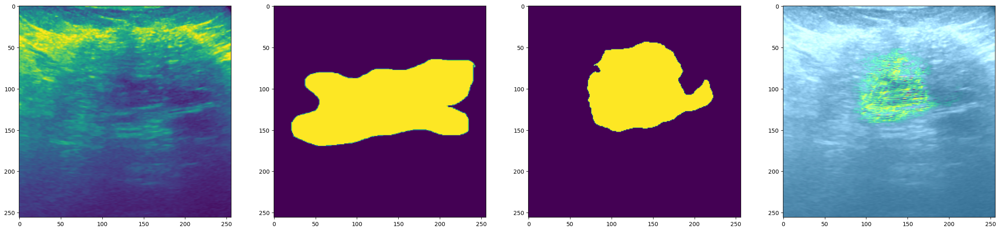

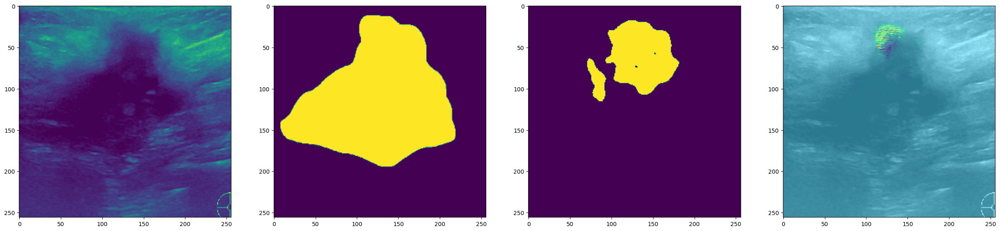

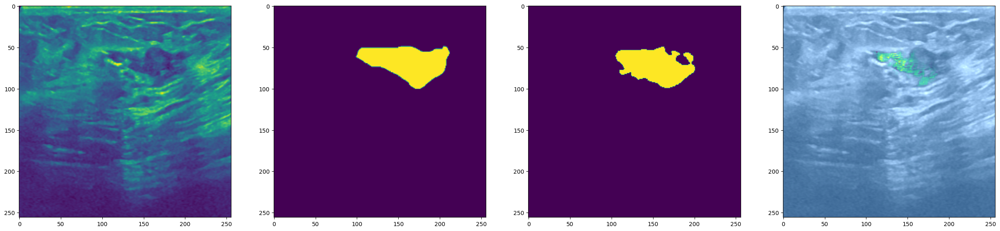

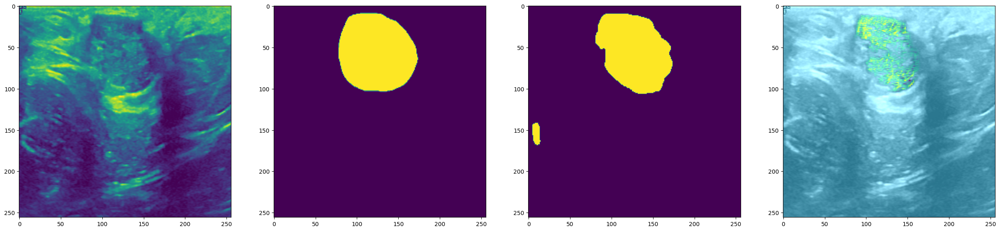

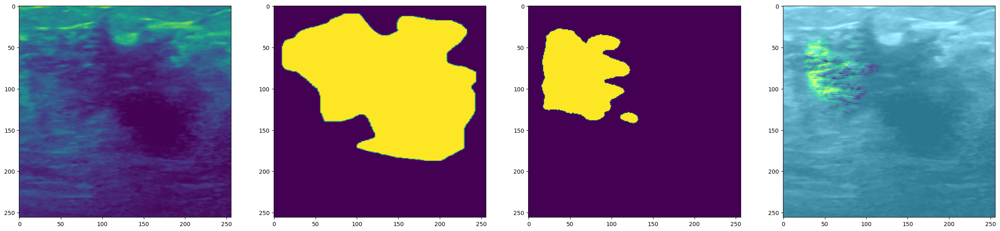

In [ ]:
y_pred_total = model.predict(dataset_test, verbose=1)
def plotter(images, masks, predicted_images, n):
    for i in range(n):
        fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(10, 5))
        plt.subplots_adjust(right=2.5, top=1.25)
        axs[0].imshow(images[i])
        axs[1].imshow(masks[i])
        #axs[2].imshow(predicted_images[i])
        axs[2].imshow(predicted_images[i] > 0.4)
        axs[3].imshow(explainer.explain((np.expand_dims(images[i], 0),masks[i]), model, layer_name = 'att2',class_index=1),cmap='gray')
        #axs[3].imshow(explainer.explain((images[i],masks[i]), model, layer_name = 'conv2d_16',class_index=1))
        #.astype(int)
        plt.show()


plotter(X_test_total,y_test_total,y_pred_total,20)
#plotter(X_train_total,y_train_total,y_pred_total,20)

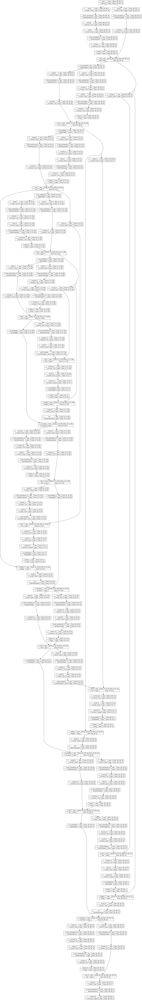

In [ ]:
tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)

In [ ]:
tf.keras.backend.clear_session()

def augmentation_layer(x):
    x = tf.keras.layers.RandomFlip(input_shape=(config.HEIGHT,
                                                config.WIDTH,
                                                config.DEPTH),
                                  seed=config.SEED,
                                  name='random_flip')(x)
    x = tf.keras.layers.RandomBrightness(0.0004,
                                         seed=config.SEED,
                                         name='random_brightness')(x)
    x = tf.keras.layers.RandomZoom(0.01,
                                   seed=config.SEED,
                                   name='random_zoom')(x)
    x = tf.keras.layers.RandomContrast(0.2,
                                       seed=config.SEED,
                                       name='random_contrast')(x)
    x = tf.keras.layers.RandomTranslation(height_factor=0.05,
                                          width_factor=0.05,
                                          seed=config.SEED,
                                          name='random_translation')(x)
    x = tf.keras.layers.RandomRotation(0.05,
                                       seed=config.SEED,
                                       name='random_rotation')(x)
    return x

#convolutional block
def conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'1')(x)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'1BN')(conv)
    conv = layers.Activation("relu",name=name+'1BNact')(conv)
    if dropout > 0:
        conv = layers.Dropout(dropout)(conv)
    conv = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding="same", name=name+'2')(conv)
    if batchnorm is True:
        conv = layers.BatchNormalization(axis=3,name=name+'2BN')(conv)
    conv = layers.Activation("relu",name=name+'2BNact')(conv)
    return conv


#residual convolutional block
def res_conv_block(x, kernelsize, filters, dropout, batchnorm=False, name='conv'):
    conv1 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same', name=name+'1')(x)
    if batchnorm is True:
        conv1 = layers.BatchNormalization(axis=3,name=name+'1BN')(conv1)
    conv1 = layers.Activation('relu')(conv1)
    conv2 = layers.Conv2D(filters, (kernelsize, kernelsize), kernel_initializer='he_normal', padding='same')(conv1)
    if batchnorm is True:
        conv2 = layers.BatchNormalization(axis=3)(conv2)
        conv2 = layers.Activation("relu")(conv2)
    if dropout > 0:
        conv2 = layers.Dropout(dropout)(conv2)

    #skip connection
    shortcut = layers.Conv2D(filters, kernel_size=(1, 1), kernel_initializer='he_normal', padding='same')(x)
    if batchnorm is True:
        shortcut = layers.BatchNormalization(axis=3)(shortcut)
    shortcut = layers.Activation("relu")(shortcut)
    respath = layers.add([shortcut, conv2], name=name+'resfinal')
    return respath


#gating signal for attention unit
def gatingsignal(input, out_size, batchnorm=False, name='gate'):
    x = layers.Conv2D(out_size, (1, 1), padding='same')(input)
    if batchnorm:
        x = layers.BatchNormalization()(x)
    x = layers.Activation('relu',name=name+'_act')(x)
    return x

#attention unit/block based on soft attention
def attention_block(x, gating, inter_shape, name):
    shape_x = K.int_shape(x)
    shape_g = K.int_shape(gating)
    theta_x = layers.Conv2D(inter_shape, (2, 2), strides=(2, 2),
                            kernel_initializer='he_normal', padding='same')(x)
    shape_theta_x = K.int_shape(theta_x)
    phi_g = layers.Conv2D(inter_shape, (1, 1), kernel_initializer='he_normal', padding='same')(gating)
    upsample_g = layers.Conv2DTranspose(inter_shape, (3, 3), strides=(shape_theta_x[1] // shape_g[1], shape_theta_x[2] // shape_g[2]), kernel_initializer='he_normal', padding='same')(phi_g)
    concat_xg = layers.add([upsample_g, theta_x])
    act_xg = layers.Activation('relu')(concat_xg)
    psi = layers.Conv2D(1, (1, 1), kernel_initializer='he_normal', padding='same')(act_xg)
    sigmoid_xg = layers.Activation('sigmoid')(psi)
    shape_sigmoid = K.int_shape(sigmoid_xg)
    upsample_psi = layers.UpSampling2D(size=(shape_x[1] // shape_sigmoid[1], shape_x[2] // shape_sigmoid[2]))(sigmoid_xg)
    upsample_psi = layers.Lambda(lambda x, repnum: K.repeat_elements(x, repnum, axis=3), arguments={'repnum': shape_x[3]})(upsample_psi)
    y = layers.multiply([upsample_psi, x])
    result = layers.Conv2D(shape_x[3], (1, 1), kernel_initializer='he_normal', padding='same')(y)
    attenblock = layers.BatchNormalization(name=name+'_wgt')(result)
    return attenblock

#Simple U-NET
def unetmodel(input_shape, dropout=0.2, batchnorm=False):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm,name='conv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_5')(dn_5)
    up_5 = layers.concatenate([up_5, dn_4], axis=3, name='ups_5_conv_4')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='ups_conv5')

    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, dn_3], axis=3, name='ups_4_conv_3')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='ups_conv4')

    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, dn_2], axis=3, name='ups_3_conv_2')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='ups_conv3')

    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='ups_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, dn_1], axis=3, name='ups_2_conv_1')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='ups_conv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3,name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Attention U-NET
def attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='dconv_1')
    pool_1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = conv_block(pool_1, kernelsize, filters[1], dropout, batchnorm, name='dconv_2')
    pool_2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = conv_block(pool_2, kernelsize, filters[2], dropout, batchnorm, name='dconv_3')
    pool_3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = conv_block(pool_3, kernelsize, filters[3], dropout, batchnorm, name='dconv_4')
    pool_4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = conv_block(pool_4, kernelsize, filters[4], dropout, batchnorm, name='dconv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate_5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att_5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3, name='up_5_att_5')
    up_conv_5 = conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='uconv_5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate_4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att_4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3, name='up_4_att_4')
    up_conv_4 = conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='uconv_4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate_3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att_3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3, name='up_3_att_3')
    up_conv_3 = conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='uconv_3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate_2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att_2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up_2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3, name='up_2_att_2')
    up_conv_2 = conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='uconv_2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

#Residual-Attention UNET (RA-UNET)
def residual_attentionunet(input_shape, dropout=0.2, batchnorm=True):

    filters = [16, 32, 64, 128, 256]
    kernelsize = 3
    upsample_size = 2

    inputs = layers.Input(input_shape)

    # Downsampling layers
    dn_1 = res_conv_block(inputs, kernelsize, filters[0], dropout, batchnorm, name='conv_1')
    pool1 = layers.MaxPooling2D(pool_size=(2,2), name='pool_1')(dn_1)

    dn_2 = res_conv_block(pool1, kernelsize, filters[1], dropout, batchnorm, name='conv_2')
    pool2 = layers.MaxPooling2D(pool_size=(2,2), name='pool_2')(dn_2)

    dn_3 = res_conv_block(pool2, kernelsize, filters[2], dropout, batchnorm, name='conv_3')
    pool3 = layers.MaxPooling2D(pool_size=(2,2), name='pool_3')(dn_3)

    dn_4 = res_conv_block(pool3, kernelsize, filters[3], dropout, batchnorm, name='conv_4')
    pool4 = layers.MaxPooling2D(pool_size=(2,2), name='pool_4')(dn_4)

    dn_5 = res_conv_block(pool4, kernelsize, filters[4], dropout, batchnorm, name='conv_5')

    # Upsampling layers
    gating_5 = gatingsignal(dn_5, filters[3], batchnorm, name='gate5')
    att_5 = attention_block(dn_4, gating_5, filters[3], name='att5')
    up_5 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up5')(dn_5)
    up_5 = layers.concatenate([up_5, att_5], axis=3)
    up_conv_5 = res_conv_block(up_5, kernelsize, filters[3], dropout, batchnorm, name='upconv5')

    gating_4 = gatingsignal(up_conv_5, filters[2], batchnorm, name='gate4')
    att_4 = attention_block(dn_3, gating_4, filters[2], name='att4')
    up_4 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up4')(up_conv_5)
    up_4 = layers.concatenate([up_4, att_4], axis=3)
    up_conv_4 = res_conv_block(up_4, kernelsize, filters[2], dropout, batchnorm, name='upconv4')

    gating_3 = gatingsignal(up_conv_4, filters[1], batchnorm, name='gate3')
    att_3 = attention_block(dn_2, gating_3, filters[1], name='att3')
    up_3 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up3')(up_conv_4)
    up_3 = layers.concatenate([up_3, att_3], axis=3)
    up_conv_3 = res_conv_block(up_3, kernelsize, filters[1], dropout, batchnorm, name='upconv3')

    gating_2 = gatingsignal(up_conv_3, filters[0], batchnorm, name='gate2')
    att_2 = attention_block(dn_1, gating_2, filters[0], name='att2')
    up_2 = layers.UpSampling2D(size=(upsample_size, upsample_size), data_format="channels_last", name='up2')(up_conv_3)
    up_2 = layers.concatenate([up_2, att_2], axis=3)
    up_conv_2 = res_conv_block(up_2, kernelsize, filters[0], dropout, batchnorm, name='upconv2')

    conv_final = layers.Conv2D(1, kernel_size=(1,1), name='conv_final')(up_conv_2)
    conv_final = layers.BatchNormalization(axis=3, name='conv_final_BN')(conv_final)
    outputs = layers.Activation('sigmoid', name='conv_final_op')(conv_final)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    #model.summary()
    return model

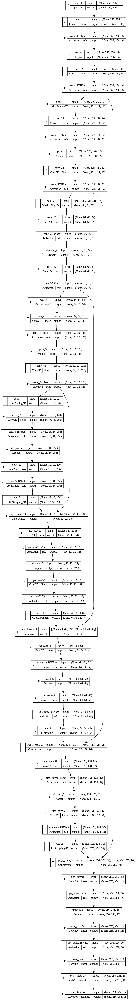

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv_11 (Conv2D)            (None, 256, 256, 16)         160       ['input_1[0][0]']             
                                                                                                  
 conv_11BNact (Activation)   (None, 256, 256, 16)         0         ['conv_11[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 256, 256, 16)         0         ['conv_11BNact[0][0]']        
                                                                                              

In [ ]:
#model = residual_attentionunet(input_shape=(256,256,1))
#model = attentionunet(input_shape=(256,256,1))
model = unetmodel(input_shape=(256,256,1))
#runet_model = residual_attentionunet(input_shape=(256,256,1))
tf.keras.utils.plot_model(model,
                          show_shapes=True,
                          show_layer_names=True,
                          show_layer_activations=True,
                          show_trainable=True)
model.summary()

In [ ]:
class Config:
    '''
    Config in which I hold all hyperparameters and frequently used variables such as image shape, train directory path etc.
    '''
    def __init__(self, DEBUG=False):
        self.DEBUG = DEBUG

    TRAIN_CSV = '../input/sartorius-cell-instance-segmentation/train.csv'
    TRAIN_DIR = '../input/sartorius-cell-instance-segmentation/train/'
    TEST_DIR = '../input/sartorius-cell-instance-segmentation/test/'

    IMG_SHAPE = (256, 256)

    LR = 1e-3

    EPOCHS = 100

    N_FILTERS = 32


    #BATCH_SIZE = 4
    AUTOTUNE = tf.data.AUTOTUNE

    N_CLASSES = 1
    #BUFFER_SIZE = 2

    #val_size = 0.1

    #WEIGHTS_PATH = os.path.join('./', 'model.h5')

    seed = 123


config = Config()

In [ ]:
def attention(input_tensor, g, inter_shape):
    input_shapes = input_tensor.shape
    g_shapes = g.shape

    x = tf.keras.layers.Conv2D(inter_shape, 1, 2, padding="same")(input_tensor)
    g = tf.keras.layers.Conv2D(inter_shape, 1, padding="same")(g)


    add = tf.keras.layers.add([x, g])
    relu = tf.keras.layers.Activation('relu')(x)

    psi = tf.keras.layers.Conv2D(1, 1, padding="same")(relu)
    sigmoid = tf.keras.layers.Activation('sigmoid')(psi)

    upsample = tf.keras.layers.UpSampling2D(size=(2, 2))(sigmoid)

    att = tf.keras.layers.multiply([upsample, input_tensor])

    output = tf.keras.layers.Conv2D(input_shapes[3], 1, padding="same")(att)
    return tf.keras.layers.BatchNormalization()(output)

def conv_block(input_tensor, n_filters, dropout=0.1, batch_norm=True):
    x_save = tf.keras.layers.Conv2D(n_filters, 3, activation="relu", padding="same")(input_tensor)
    if batch_norm:
        x = tf.keras.layers.BatchNormalization()(x_save)

    x = tf.keras.layers.Conv2D(n_filters, 3, activation="relu", padding="same")(x)
    if batch_norm:
        x = tf.keras.layers.BatchNormalization()(x)

    if dropout:
        x = tf.keras.layers.Dropout(dropout)(x)

    x = tf.keras.layers.add([x, x_save])
    x = tf.keras.layers.Activation("relu")(x)

    return x

def downsample(x, n_filters, dropout=0.1, batch_norm=True):
    res_conn = conv_block(x, n_filters, dropout=dropout, batch_norm=batch_norm)

    x = tf.keras.layers.MaxPool2D((2, 2), strides=(2, 2))(res_conn)

    return x, res_conn

def upsample(x, n_filters, skip_conn, dropout=0.1, batch_norm=True):
    att = attention(skip_conn, x, n_filters)
    x = tf.keras.layers.Conv2DTranspose(n_filters, (2, 2), strides=2, padding="same", activation="relu")(x)
    x = tf.keras.layers.Concatenate()([x, att])
    x = conv_block(x, n_filters)

    if dropout:
        x = tf.keras.layers.Dropout(dropout)(x)

    if batch_norm:
        x = tf.keras.layers.BatchNormalization()(x)

    return x

def create_model(n_filters):
    inputs = tf.keras.layers.Input(shape=(*Config.IMG_SHAPE, 1))

    x, skip_conn1 = downsample(inputs, n_filters)
    x, skip_conn2 = downsample(x, n_filters * 2)
    x, skip_conn3 = downsample(x, n_filters * 4)
    x, skip_conn4 = downsample(x, n_filters * 8)

    x = conv_block(x, n_filters * 16)

    x = upsample(x, n_filters * 8, skip_conn4)
    x = upsample(x, n_filters * 4, skip_conn3)
    x = upsample(x, n_filters * 2, skip_conn2)
    x = upsample(x, n_filters, skip_conn1)

    outputs = tf.keras.layers.Conv2D(config.N_CLASSES, 1, activation="sigmoid", padding="same")(x)

    return tf.keras.Model(inputs=inputs, outputs=outputs)

In [ ]:
unet_model = create_model(config.N_FILTERS)
unet_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 32)         320       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 32)         128       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 32)         9248      ['batch_normalization[0][0

In [ ]:
def dice_loss(y_true, y_pred, smooth=1.0):
    y_true = tf.cast(y_true, tf.float32)
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return 1 - (2. * intersection + smooth) / (K.sum(K.square(y_true_f)) + K.sum(K.square(y_pred_f)) + smooth)

def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3]) + K.sum(y_pred,[1,2,3]) - intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=config.LR)

metrics = [iou_coef]
unet_model.compile(optimizer=optimizer, loss=dice_loss, metrics=metrics)

In [ ]:
cp_callback = tf.keras.callbacks.ModelCheckpoint(
    config.WEIGHTS_PATH,
    save_best_only=True,
    save_weights_only=True,
    verbose=1,
    monitor="val_loss",
    mode="min"
)

rlr_callback = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.01,
    patience=5,
    min_delta=1e-2
)

es_callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=1e-2,
    patience=15,
    verbose=1,
    mode='min',
)

In [ ]:
history = model.fit(
    train_d,
    epochs=config.EPOCHS,
    validation_data=val_ds,
    callbacks=[cp_callback, rlr_callback, es_callback]
)

In [ ]:

benign = 'benign'
malignant = 'malignant'
normal = 'normal'

benign_dir = os.path.join(config.DATA_DIR,benign)
malignant_dir = os.path.join(config.DATA_DIR,malignant)
config.NORMAL_DIR = os.path.join(config.DATA_DIR,normal)

def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])])
            cls = [i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Convert the mask to a binary image
            msk_binary = cv2.cvtColor(msk, cv2.COLOR_BGR2GRAY)
            #print(msk_binary.shape)
            ret, msk_binary = cv2.threshold(msk_binary, 1, 255, cv2.THRESH_BINARY)
            #print(msk_binary.shape)

            # Create a transparent mask using alpha channel
            #lpha_channel = msk_binary.astype(float) / 255.0
            #img_with_mask = img.copy()
            #print(img_with_mask.shape)
            #img_with_mask[:, :, 3] = alpha_channel

            plot3(img, msk, image)

def plot3(img1, img2, title=None):
    fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)

    for i, img in enumerate([img1, img2]):
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
        if title:
            axs[i].set_title(title)
    axs[2].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    axs[2].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB),alpha=0.5)
    plt.show()


# Select 8 random images from each class
benign_images = select_random_images(benign_dir, 2)
malignant_images = select_random_images(malignant_dir, 2)
normal_images = select_random_images(config.NORMAL_DIR, 2)

In [ ]:
dataset_train

In [ ]:


f, axarr = plt.subplots(2,3)
f.set_size_inches(20,10)
ix = random.randint(0, len(train_ids[1]))
axarr[0,0].imshow(X_train[ix])
axarr[0,0].set_title('Microscope')
axarr[0,1].imshow(np.squeeze(Y_predict[ix]))
axarr[0,1].set_title('"Predicted" Masks')
axarr[0,2].imshow(np.squeeze(y_train[ix]))
axarr[0,2].set_title('"GroundTruth" Masks')

axarr[1,0].imshow(X_train[ix])
axarr[1,0].set_title('Microscope')
axarr[1,1].imshow(np.squeeze(Y_predict[ix]))
axarr[1,1].set_title('"Predicted" Masks')
axarr[1,2].imshow(np.squeeze(y_train[ix]))
axarr[1,2].set_title('"GroundTruth" Masks')

plt.show()

In [ ]:
#Y_predict
for i,j in dataset_test:print(i)

In [ ]:
#dataset_test[0]

TypeError: ignored

In [ ]:
unet_model.fit()

ValueError: Failed to find data adapter that can handle input: <class 'NoneType'>, <class 'NoneType'>

In [ ]:
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)

IMG_WIDTH       = 256
IMG_HEIGHT      = 256
IMG_CHANNELS    = 1


In [ ]:
#!pip install pydot
#!pip install pydotplus

     ---------------------------------------- 0.0/278.7 kB ? eta -:--:--
     ----- ------------------------------- 41.0/278.7 kB 991.0 kB/s eta 0:00:01
     --------------------------- ---------- 204.8/278.7 kB 2.1 MB/s eta 0:00:01
     -------------------------------------  276.5/278.7 kB 1.9 MB/s eta 0:00:01
     -------------------------------------- 278.7/278.7 kB 1.6 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for pydotplus: filename=pydotplus-2.0.2-py3-none-any.whl size=24574 sha256=812eee61051a26183fda9b640a1c189d61a3fa9b56eb86f92c34ec791f092d6d
  Stored in directory: c:\users\kbged\appdata\local\pip\cache\wheels\89\e5\de\6966007cf223872eedfbebbe0e074534e72e9128c8fd4b55eb
Successfully built pydotplus


In [ ]:
!pip install graphviz

     ---------------------------------------- 0.0/47.0 kB ? eta -:--:--
     ---------------------------------- ----- 41.0/47.0 kB 1.9 MB/s eta 0:00:01
     -------------------------------------- 47.0/47.0 kB 593.5 kB/s eta 0:00:00


In [ ]:
def load_train_dataset(x,y,batch_size):

    dataset = tf.data.Dataset.from_tensor_slices((x, y))


<_TensorSliceDataset element_spec=(TensorSpec(shape=(256, 256, 1), dtype=tf.float64, name=None), TensorSpec(shape=(256, 256, 1), dtype=tf.float64, name=None))>

In [ ]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip(input_shape=(img_height,
                                  img_width,
                                  1)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
    tf.keras.layers.RandomContrast(0.1),
    tf.keras.layers.RandomTranslation(height_factor=0.1,width_factor=0.1)
  ]
)

In [ ]:
import sklearn
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator

X_train_benign, X_test_benign, y_train_benign, y_test_benign = train_test_split(x_benign,
                                                                                y_benign,
                                                                                test_size=0.1)
X_train_malignant, X_test_malignant, y_train_malignant, y_test_malignant = train_test_split(x_malignant,
                                                                                y_malignant,
                                                                                test_size=0.1)


print(f'\033[92m')
print('X_train shape:',X_train_benign.shape)
print('y_train shape:',y_train_benign.shape)
print('X_test shape:',X_test_benign.shape)
print('y_test shape:',y_test_benign.shape)


X_train shape: (393, 256, 256, 1)
y_train shape: (393, 256, 256, 1)
X_test shape: (44, 256, 256, 1)
y_test shape: (44, 256, 256, 1)


['benign']


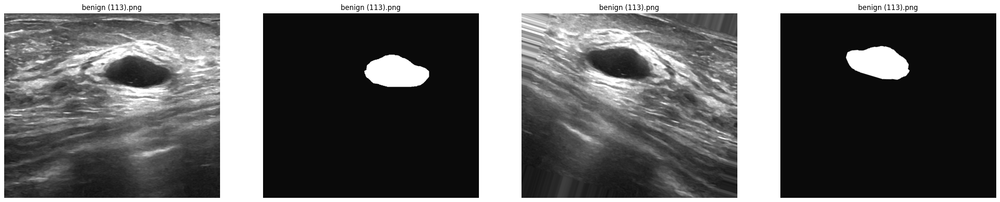

['benign']


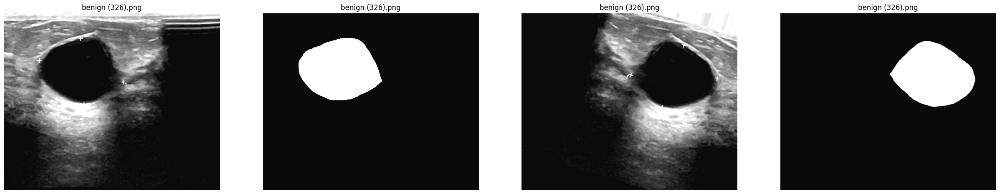

['malignant']


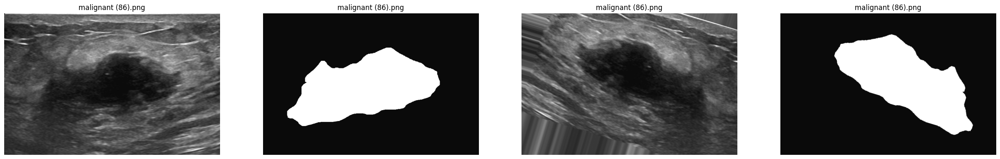

['malignant']


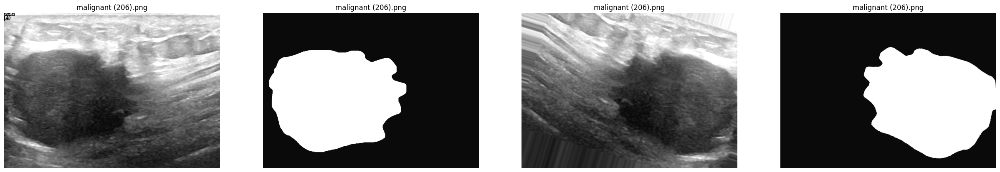

['normal']


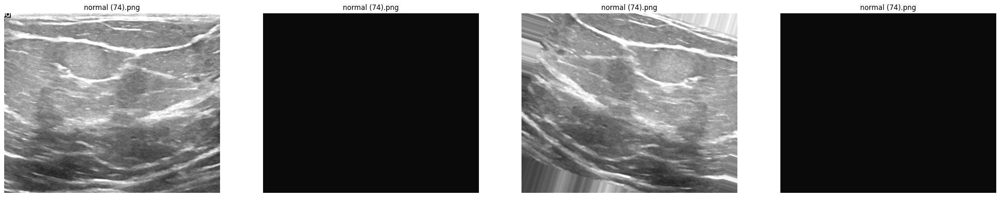

['normal']


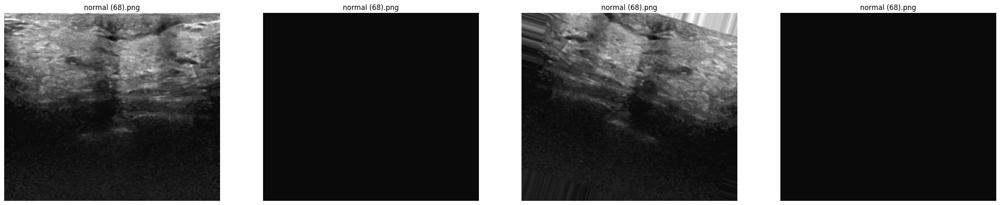

In [ ]:
# Preprocessing parameters
noise_reduction_kernel_size = 3
contrast_alpha = 1.2
contrast_beta = 10

data_augmentation = ImageDataGenerator(
    rotation_range=30,
    horizontal_flip=True,
    vertical_flip=True,
    # elastic_deformation=True
)

benign_dir = os.path.join(config.DATA_DIR,benign)
malignant_dir = os.path.join(config.DATA_DIR,malignant)
config.NORMAL_DIR = os.path.join(config.DATA_DIR,normal)

def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])])
            cls = [i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Apply preprocessing
            img = cv2.medianBlur(img, noise_reduction_kernel_size)
            img = cv2.convertScaleAbs(img, alpha=contrast_alpha, beta=contrast_beta)
            msk = cv2.medianBlur(msk, noise_reduction_kernel_size)
            msk = cv2.convertScaleAbs(msk, alpha=contrast_alpha, beta=contrast_beta)

            # Apply data augmentation
            augmented_images = data_augmentation.flow(np.expand_dims(img, axis=0),
                                                      batch_size=1,
                                                      seed=13)
            augmented_image = next(augmented_images)[0].astype(np.uint8)
            augmented_msks = data_augmentation.flow(np.expand_dims(msk, axis=0),
                                                    batch_size=1,
                                                    seed=13)
            augmented_msk = next(augmented_msks)[0].astype(np.uint8)

            plot4(img, msk, augmented_image, augmented_msk, image)

def plot4(img, msk, augmented_image, augmented_msk, title=None):
    fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(10, 5))
    plt.subplots_adjust(right=2.5, top=1.25)

    for i, img in enumerate([img, msk, augmented_image, augmented_msk]):
        axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i].axis('off')
        if title:
            axs[i].set_title(title)
    #axs[2].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    #axs[2].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB),alpha=0.5)
    plt.show()


# Select 8 random images from each class
benign_images = select_random_images(benign_dir, 2)
malignant_images = select_random_images(malignant_dir, 2)
normal_images = select_random_images(config.NORMAL_DIR, 2)


In [ ]:
data_gen_args = dict(rotation_range=45.,
                     width_shift_range=0.1,
                     height_shift_range=0.1,
                     shear_range=0.2,
                     zoom_range=0.2,
                     horizontal_flip=True,
                     vertical_flip=True,
                     fill_mode='reflect')

In [ ]:
# Preprocessing parameters
noise_reduction_kernel_size = 3
contrast_alpha = 1.2
contrast_beta = 10

load_train_data()


data_augmentation = ImageDataGenerator(
    rotation_range=30,
    horizontal_flip=True,
    vertical_flip=True,
    # elastic_deformation=True
)

benign_dir = os.path.join(config.DATA_DIR,benign)
malignant_dir = os.path.join(config.DATA_DIR,malignant)
config.NORMAL_DIR = os.path.join(config.DATA_DIR,normal)

def select_random_images(folder,n, plot=True):
    images_list = os.listdir(folder)
    images_list = [i for i in images_list if 'mask' not in i]
    #print(images_list)
    random.shuffle(images_list)
    selected_files = images_list[:n]
    mask_files = [i.replace(')',')_mask') for i in selected_files]

    if plot:
        for image, mask in zip(selected_files, mask_files):
            print([i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])])
            cls = [i for i in [benign,normal,malignant] if all([i in [benign,normal,malignant], i in image])][0]

            image_path = os.path.join(config.DATA_DIR,cls, image)
            mask_path = os.path.join(config.DATA_DIR,cls, mask)
            img = cv2.imread(image_path)
            msk = cv2.imread(mask_path)
            #print(img.shape,msk.shape)

            # Apply preprocessing
            img = cv2.medianBlur(img, noise_reduction_kernel_size)
            img = cv2.convertScaleAbs(img, alpha=contrast_alpha, beta=contrast_beta)
            msk = cv2.medianBlur(msk, noise_reduction_kernel_size)
            msk = cv2.convertScaleAbs(msk, alpha=contrast_alpha, beta=contrast_beta)

            # Apply data augmentation
            augmented_images = data_augmentation.flow(np.expand_dims(img, axis=0),
                                                      batch_size=1,
                                                      seed=13)
            augmented_image = next(augmented_images)[0].astype(np.uint8)
            augmented_msks = data_augmentation.flow(np.expand_dims(msk, axis=0),
                                                    batch_size=1,
                                                    seed=13)
            augmented_msk = next(augmented_msks)[0].astype(np.uint8)

            plot4(img, msk, augmented_image, augmented_msk, image)


In [ ]:
tf.keras.utils.image_dataset_from_directory(
    directory,
    labels='inferred',
    label_mode='int',
    class_names=None,
    color_mode='rgb',
    batch_size=32,
    image_size=(256, 256),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation='bilinear',
    follow_links=False,
    crop_to_aspect_ratio=False,
    **kwargs
)

In [ ]:
!pip install tensorflow[and-cuda]

INFO: pip is looking at multiple versions of tensorflow[and-cuda] to determine which version is compatible with other requirements. This could take a while.
  Using cached nvidia_cublas_cu11-11.11.3.6-py3-none-win_amd64.whl (427.2 MB)
  Using cached nvidia_cuda_cupti_cu11-11.8.87-py3-none-win_amd64.whl (10.0 MB)
  Using cached nvidia_cuda_nvcc_cu11-11.8.89-py3-none-win_amd64.whl (15.7 MB)
  Using cached nvidia_cuda_runtime_cu11-11.8.89-py3-none-win_amd64.whl (1.0 MB)
  Using cached absl_py-2.0.0-py3-none-any.whl.metadata (2.3 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl (12 kB)
  Using cached flatbuffers-23.5.26-py2.py3-none-any.whl.metadata (850 bytes)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl (57 kB)
  Using cached libclang-16.0.6-py2.py3-none-win_amd64.whl.metadata (5.3 kB)
     ---------------------------------------- 0.0/14.9 MB ? eta -:--:--
     ---------------------------------------- 0.1/14.9 MB 2.6 MB/s 

  You can safely remove it manually.
  You can safely remove it manually.


In [ ]:

sorted(glob.glob(config.DATA_DIR+'*/*'))

['../data/raw/Dataset_BUSI_with_GT\\benign\\benign (1).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (1)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (10).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (10)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (100).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (100)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (100)_mask_1.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (101).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (101)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (102).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (102)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (103).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (103)_mask.png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (104).png',
 '../data/raw/Dataset_BUSI_with_GT\\benign\\benign (104)_mask.png',
 '../data/raw/Datas

In [ ]:
benign = 'benign'
maligant = 'maligant'
normal = 'normal'
[i for i in [benign,normal,maligant] if all([i in [benign,normal,maligant], i in benign])]

['benign']

In [ ]:
benign_images[0]

['benign (184).png', 'benign (324).png']

In [ ]:
img.shape

(469, 562, 3)

In [ ]:
    # Convert the mask to a binary image
    msk_binary = cv2.cvtColor(msk, cv2.COLOR_BGR2GRAY)
    ret, msk_binary = cv2.threshold(msk_binary, 1, 255, cv2.THRESH_BINARY)

    # Create a transparent mask using alpha channel
    alpha_channel = msk_binary.astype(float) / 255.0
    img_with_mask = img.copy()
    img_with_mask[:, :, 3] = alpha_channel

    # Plot the original image and the image with overlaid mask
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    axs[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Original Image')

    axs[1].imshow(cv2.cvtColor(img_with_mask, cv2.COLOR_BGRA2RGBA))
    axs[1].set_title('Image with Mask Overlay')